# Moonsoon - a fantasy map generator powered by numpy

![example1](example1.png)

In [201]:
import noise
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.colors import to_rgba
from scipy.signal import convolve2d
from math import exp
from tqdm import tqdm
import matplotlib.animation as animation
import heapq
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import Image
from scipy.spatial import Voronoi, voronoi_plot_2d
import skimage.transform
#help(noise)
#http://libnoise.sourceforge.net/glossary/
def sample2D(a,i,j):
    i,j=np.clip(i,0,a.shape[0]-1),np.clip(j,0,a.shape[1]-1)
    i0,i1,j0,j1=int(np.floor(i)),int(np.ceil(i)),int(np.floor(j)),int(np.ceil(j))
    return a[i0,j0]*(i1-i)*(j1-j)+a[i1,j0]*(i-i0)*(j1-j)+a[i0,j1]*(i1-i)*(j-j0)+a[i1,j1]*(i-i0)*(j-j0)
def clip(value, lower, upper):
    return lower if value < lower else upper if value > upper else value

In [215]:
#seeds and parameters
seed=77
townseed=3
histseed=7
size=400
zoom=30
zoom2=4
travel_zoom=.7
villagedense=40
x0,y0=2,0
distortion=2
distortion2=.5

***
## Day 1, Let there be Landmass, and Continents should be continuous

We start from some simple [Perlin Noise](https://en.wikipedia.org/wiki/Perlin_noise)

We first define the shape of the continent

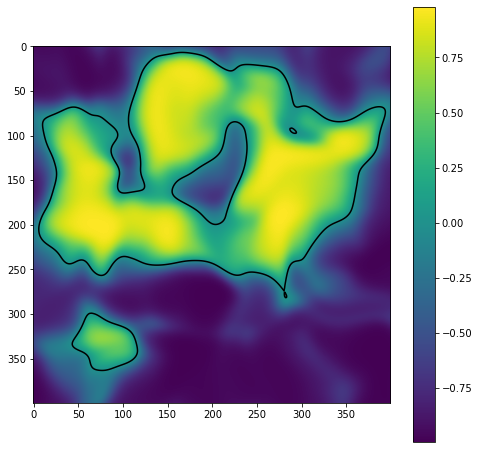

In [216]:
gammas = np.zeros((size,size))
xcoord,ycoord=np.mgrid[0:size,0:size]/zoom
xcoord+=x0
ycoord+=y0
for i in range(size):
    for j in range(size):
        x,y=i/zoom+x0,j/zoom+y0
        dx=distortion2*noise.pnoise2(x/zoom2,y/zoom2,octaves=2,persistence=0.5,lacunarity=2.0,base=seed+15)
        dy=distortion2*noise.pnoise2(x/zoom2,y/zoom2,octaves=2,persistence=0.5,lacunarity=2.0,base=seed+23)
        r=np.sqrt((x-.5*size/zoom)**2+.5*(y-.5*size/zoom)**2)/zoom2 # do not distort here
        gamma=noise.pnoise2(x/zoom2+dx,y/zoom2+dy,octaves=2,persistence=0.7,lacunarity=2,base=seed+66)*2
        gamma=np.tanh((1-r)*5)+gamma*2-.1
        gammas[i,j]=np.tanh(gamma)

plt.figure(figsize=(8,8))
plt.imshow(gammas,cmap='viridis')
plt.colorbar()
#plt.imshow(np.ma.masked_where(gammas>0,np.ones(gammas.shape)),cmap='summer')
plt.contour(gammas,[0],colors='black')
plt.show()

I used another layer of perlin noise for the mountains. So I can have a better control that how many mountains are there on the continent.

To make the terrain more interesting, I also warpped the coordinates by another perlin noise to emulate tectonic movement. So I can have some curvy mountain ridges

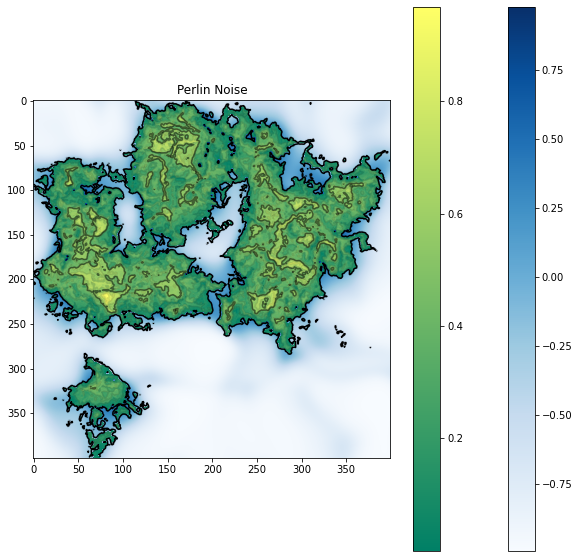

In [217]:
# get elevation

elevation = np.zeros((size,size))
for i in range(size):
    for j in range(size):
        x,y=i/zoom+x0,j/zoom+y0
        dx=distortion*noise.pnoise2(x,y,octaves=4,persistence=0.5,lacunarity=2.0,base=seed+15)
        dy=distortion*noise.pnoise2(x,y,octaves=4,persistence=0.5,lacunarity=2.0,base=seed+23)
        value=noise.pnoise2(x+dx,y+dy,octaves=6,persistence=0.5,lacunarity=2.0,base=seed+0)*2
        value=(value+gammas[i,j])/2
        elevation[i,j] = value

plt.figure(figsize=(10,10))
plt.imshow(gammas,cmap='Blues')
plt.colorbar()
plt.imshow(np.ma.masked_where(elevation<0,elevation),cmap='summer')
plt.colorbar()
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0.5],colors='black',alpha=0.5)
plt.contour(elevation,[0],colors='black')
plt.title("Perlin Noise")
plt.show()

***
To make the continent more continuous, remove the small in-land oceans by [flood filling](https://en.wikipedia.org/wiki/Flood_fill) them to an elevation slightly above sealevel

It gives me some decent plains

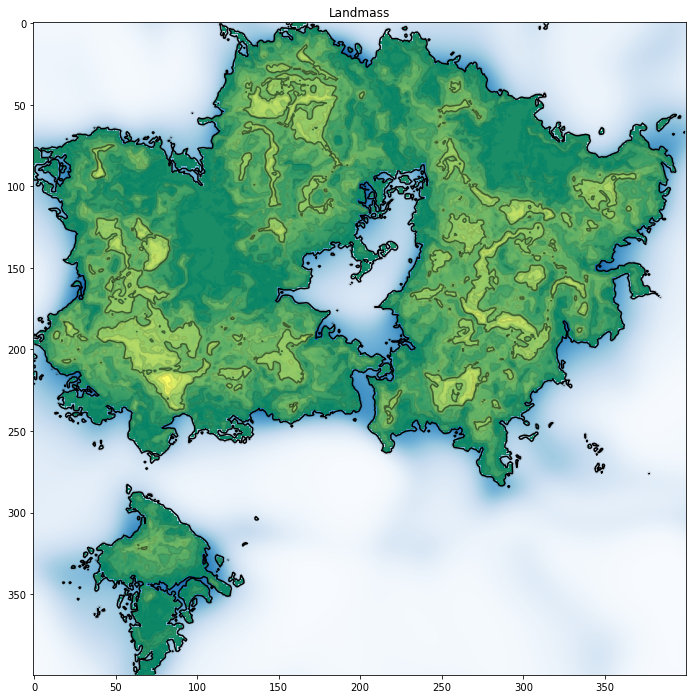

In [218]:
# fillout small oceans
def fill_ocean(minsize,threshold=0,target=0.05):
    visited=elevation<-1
    dirs=((0,1),(1,0),(0,-1),(-1,0))
    for i0 in range(size):
        for j0 in range(size):
            if elevation[i0,j0]<=threshold and not visited[i0,j0]:
                opened=[]
                closed=[]
                count=0
                opened.append((i0,j0))
                visited[i0,j0]=True
                count+=1
                while len(opened)>0:
                    i,j=opened.pop()
                    closed.append((i,j))
                    for oo,delta in enumerate(dirs):
                        ii,jj=i+delta[0],j+delta[1]
                        if 0<=ii and ii<size and 0<=jj and jj<size:
                            if not visited[ii,jj] and elevation[ii,jj]<=threshold:
                                opened.append((ii,jj))
                                visited[ii,jj]=True
                                count+=1
                        else:
                            count+=2*zoom
                if count<minsize:
                    for p in closed:
                        elevation[p[0],p[1]]=target
fill_ocean(2*zoom**2,-0.1,0.1)
fill_ocean(2*zoom**2,0.01,0.05)

plt.figure(figsize=(12,12))
plt.imshow(gammas,cmap='Blues')
plt.imshow(np.ma.masked_where(elevation<0,elevation),cmap='summer')
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0.5],colors='black',alpha=0.5)
plt.contour(elevation,[0],colors='black')
plt.title('Landmass')
plt.show()

***
## Day 2, Let there be Water. Rain brining water from ocean and shape the land, forming Plateaus, Lakes and Rivers

### Day 2.1 Rains

For each point on the land, we evaluate its distance to ocean using [Dijkstra's algorithm](https://en.wikipedia.org/wiki/Breadth-first_search) (which is a BFS with a priority queue)

The cost of water vapor traveling is penetrated by elevation and slope. So one can achieve a nice [rain shadow](https://en.wikipedia.org/wiki/Rain_shadow) for the inland, mountain surrounded areas.

I also make the water vapor more likely to travel *East*, to create some anisotropy.

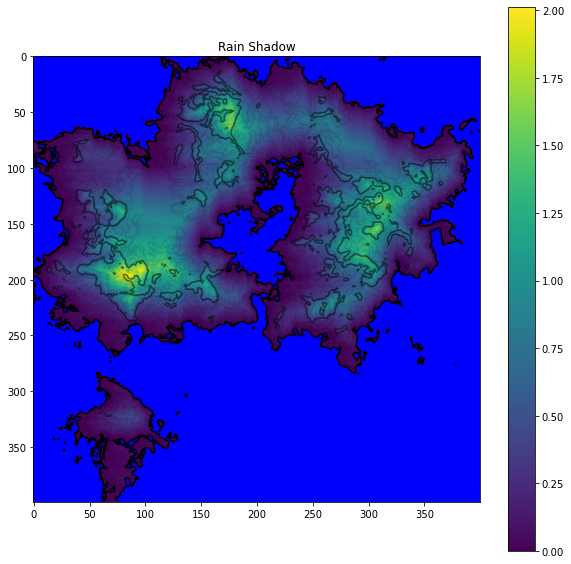

In [219]:
# get rainshadow
dist=np.zeros((size,size))
dist.fill(float('inf'))
dirs=((0,1),(1,0),(0,-1),(-1,0))
opened=[]
for i in range(size):
    for j in range(size):
        if elevation[i,j]<=0:
            opened.append((0,i,j,0))
heapq.heapify(opened)
while len(opened)>0:
    d,i,j,o=heapq.heappop(opened)
    if dist[i,j]>d:
        dist[i,j]=d
        for oo,delta in enumerate(dirs):
            ii,jj=i+delta[0],j+delta[1]
            if 0<=ii and ii<size and 0<=jj and jj<size:
                if elevation[ii,jj]>0:
                    cost=elevation[ii,jj]+0.5*(1-delta[1])
                    if elevation[ii,jj]>0.5:
                        cost+=1
                    if dist[ii,jj]>d+cost:
                        heapq.heappush(opened,(d+cost,ii,jj,oo))
rainshadow=dist.copy()/zoom
del dist,dirs,opened

plt.figure(figsize=(10,10))
plt.imshow(rainshadow,cmap='viridis')
plt.colorbar()

plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0.5],colors='black',alpha=0.5)
plt.contour(elevation,[0],colors='black')
plt.imshow(np.ma.masked_where(elevation>0,np.zeros(elevation.shape)),cmap='winter')
plt.title('Rain Shadow')
plt.show()

***
The precipitation is negatively exponent to the travel cost

I contoured the area with percipitation lower than 0.5 and 0.15 by yellow and red

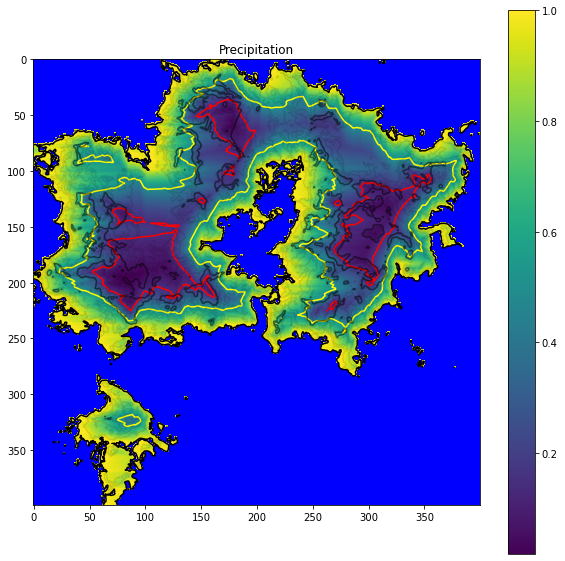

In [228]:
rain=np.exp(-rainshadow/.5)

plt.figure(figsize=(10,10))
plt.imshow(rain,cmap='viridis')
plt.colorbar()
plt.contour(rain,[0.5],colors='yellow')
plt.contour(rain,[0.15],colors='red')

plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0.5],colors='black',alpha=0.5)
plt.contour(elevation,[0],colors='black')
plt.imshow(np.ma.masked_where(elevation>0,np.ones(elevation.shape)),cmap='winter')
plt.title('Precipitation')
plt.show()

### Day 2.2 Find the valleys to fill

Now comes the tricky part. We shall fill the valleys by rainfalls and sediments, to make them become either plateaus, or lakes. Then the land is more even and there will be more flat spaces at altitude higher than sealevel.

A valley is deinfed as an region surrounded by mountains. More formally, it is defined as the maximum area where all the surrounded pixed has a higher elevation than the highest elevation in this area. It means there must be a [saddle](https://en.wikipedia.org/wiki/Saddle_(landform)), or mountain pass. The water or sediment will keep flooding the whole valley until it reaches the lowerest saddle and flow out.

After filling the whole valley, one can find from any point on the land a *non-ascending* path to the ocean

This whole process can be done in O(NxN). (NxN is the map size). The algorithm was discussed in [this article](https://medium.com/universe-factory/how-i-generated-artificial-rivers-on-imaginary-continents-747df12c5d4c). 


The basic idea is to use a modified Dijkstra's algorithm (Or BFS) to raise the sea level bit by bit to find the saddle, and floodfill the valley inside the new saddle: I kept a priority queue for all the pixels adjacent to the sea, sorted by their elevation. Then I raise the "sealevel" to the lowerest saddle, and check if it opened some valley to floodfill. So I expanded the "sea" and added more pixels into the queue. I iterate this process until all pixels are flooded.

***
The graph below shows how much additional elevation it is needed to fill the valley

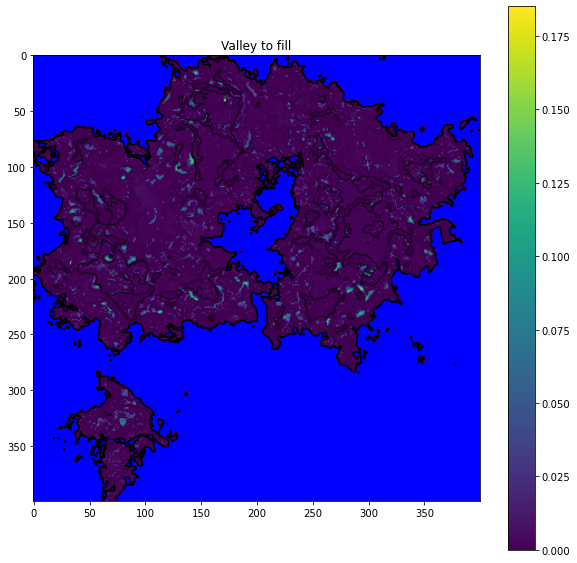

In [229]:
# get lakes and waterflow
# https://medium.com/universe-factory/how-i-generated-artificial-rivers-on-imaginary-continents-747df12c5d4c

fill=np.clip(elevation,0,1)
orig=np.zeros((size,size),dtype=np.int8)
drained=elevation<-1
dirs=((0,1),(1,0),(0,-1),(-1,0))
opened=[]
for i in range(size):
    for j in range(size):
        if elevation[i,j]<-0.01:
            opened.append((0,i,j,0))
heapq.heapify(opened)
#this bfs runs unexpectionally slow. may debug
np.random.seed(seed+2564)
while len(opened)>0:
    f,i,j,o=heapq.heappop(opened)
    if not drained[i,j]:
        drained[i,j]=True
        fill[i,j]=f
        orig[i,j]=(o+2)%4
        for oo,delta in enumerate(dirs):
            ii,jj=i+delta[0],j+delta[1]
            if 0<=ii and ii<size and 0<=jj and jj<size:
                if not drained[ii,jj]:
                    ff=max(f,clip(elevation[ii,jj],0,1))+np.random.random()*0.001
                    #random breaks priority but not break algorithm, why?
                    #ff=max(f,clip(elevation[ii,jj],0,1))+random[ii,jj]*0.01+random[i,j]*0.005
                    heapq.heappush(opened,(ff,ii,jj,oo))
fill-=np.clip(elevation,0,1)
downstream=orig.copy()

plt.figure(figsize=(10,10))
plt.imshow(elevation>0,alpha=0.5)
plt.imshow(fill,cmap='viridis')
plt.colorbar()

plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0.5],colors='black',alpha=0.5)
plt.contour(elevation,[0],colors='black')
plt.imshow(np.ma.masked_where(elevation>0,np.ones(elevation.shape)),cmap='winter')
plt.title('Valley to fill')
plt.show()


***
I filled the valleys which is bigger than a threshold into plateau, and left the smaller valleys for lakes

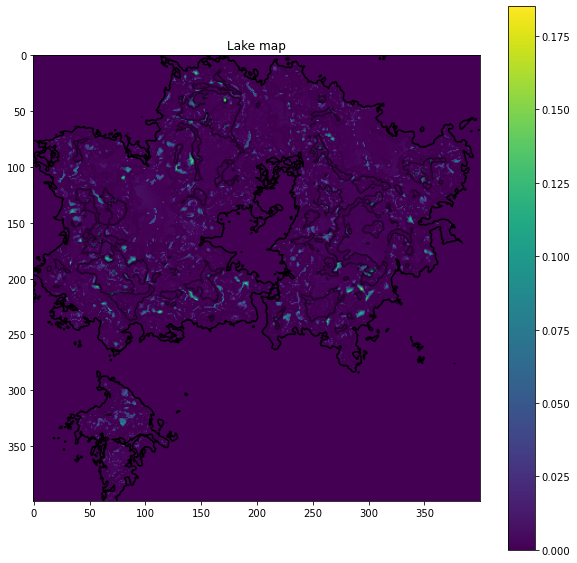

In [230]:
# fillout big lakes
visited=elevation<-1
dirs=((0,1),(1,0),(0,-1),(-1,0))
for i0 in range(size):
    for j0 in range(size):
        if fill[i0,j0]>0.01 and not visited[i0,j0]:
            opened=[]
            closed=[]
            count=0
            opened.append((i0,j0))
            visited[i0,j0]=True
            count+=1
            while len(opened)>0:
                i,j=opened.pop()
                closed.append((i,j))
                for oo,delta in enumerate(dirs):
                    ii,jj=i+delta[0],j+delta[1]
                    if 0<=ii and ii<size and 0<=jj and jj<size:
                        if not visited[ii,jj] and fill[ii,jj]>0.01:
                            opened.append((ii,jj))
                            visited[ii,jj]=True
                            count+=1
            if count>0.05*zoom**2:
                for p in closed:
                    elevation[p[0],p[1]]+=fill[p[0],p[1]]
                    fill[p[0],p[1]]=0
                    
plt.figure(figsize=(10,10))
plt.imshow(elevation>0,alpha=0.5)
plt.imshow(fill,cmap='viridis')
plt.colorbar()
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0.5],colors='black',alpha=0.5)
plt.contour(elevation,[0],colors='black')
plt.title('Lake map')
plt.show()

### Day 2.3 Rivers

Now it's time for rivers. I divised a [topological sorting](https://en.wikipedia.org/wiki/Topological_sorting) algorithm based on the fact that water can only flow downhills. During the sorting I summed up all the precipitations from the leaf nodes of the river as the flow of the river. I did not consider evaporation

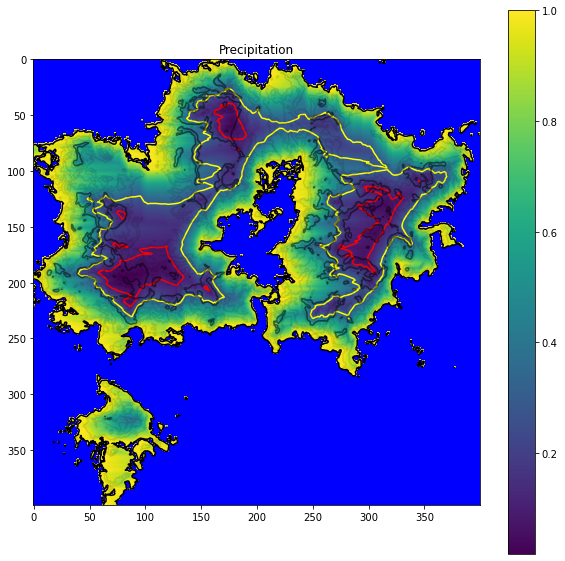

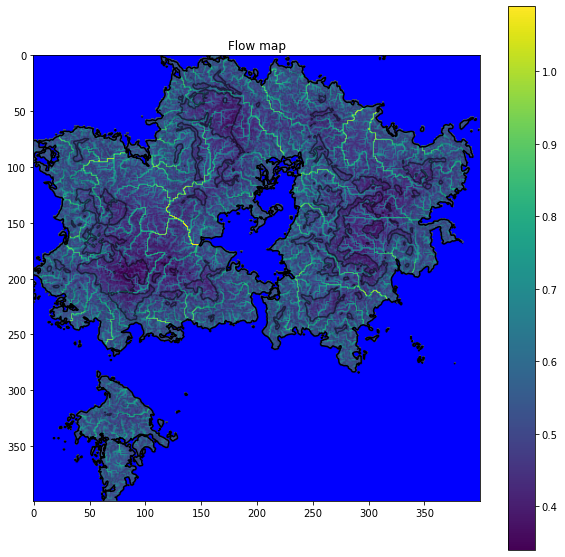

In [231]:
# generate rivers
flow=rain.copy()
degrees=np.zeros((size,size),dtype=np.int8)
dirs=((0,1),(1,0),(0,-1),(-1,0))
opened=[]
for i in range(size):
    for j in range(size):
        if elevation[i,j]>0:
            found=False
            for oo,delta in enumerate(dirs):
                ii,jj=i+delta[0],j+delta[1]
                if 0<=ii and ii<size and 0<=jj and jj<size:
                    if elevation[ii,jj]>0:
                        if downstream[ii,jj]==(oo+2)%4:
                            found=True
                            degrees[i,j]+=1
            if degrees[i,j]==0:
                degrees[i,j]=1
                opened.append((i,j,0))
while len(opened)>0:
    i,j,f=opened.pop()
    flow[i,j]+=f
    degrees[i,j]-=1
    if degrees[i,j]==0:
        o=downstream[i,j]
        ii,jj=i+dirs[o][0],j+dirs[o][1]
        if elevation[ii,jj]>0:
            opened.append((ii,jj,flow[i,j]))
            if flow[i,j]>1.5/zoom and elevation[i,j]+fill[i,j]<elevation[ii,jj]+fill[ii,jj]:
                elevation[ii,jj]=elevation[i,j]+fill[i,j]-fill[ii,jj]
flow/=zoom**2
    
plt.figure(figsize=(10,10))
plt.imshow(rain,cmap='viridis')
plt.colorbar()
plt.contour(rain,[0.3],colors='yellow')
plt.contour(rain,[0.1],colors='red')

plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0.5],colors='black',alpha=0.5)
plt.contour(elevation,[0],colors='black')
plt.imshow(np.ma.masked_where(elevation>0,np.ones(elevation.shape)),cmap='winter')
plt.title('Precipitation')
plt.show()



plt.figure(figsize=(10,10))
plt.gray()
plt.imshow(flow**0.1,cmap='viridis')
plt.colorbar()

plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0.5],colors='black',alpha=0.5)
plt.contour(elevation,[0],colors='black')
plt.imshow(np.ma.masked_where(elevation>0,np.ones(elevation.shape)),cmap='winter')
plt.title('Flow map')
plt.show()

***
The last thing to do is to evaluate the slope and unevenness. We shall see from the histogram that most of the land are flat, due to the previous flood filling precedure.

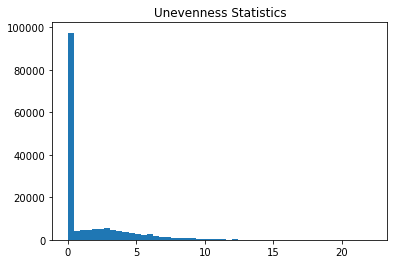

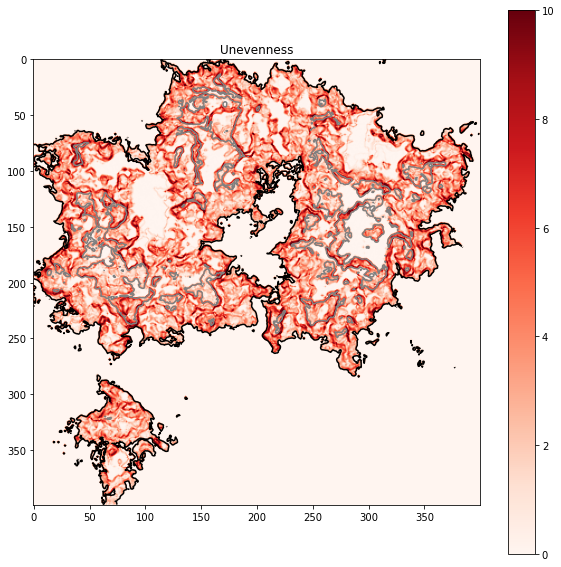

In [232]:
ef=np.clip(elevation,0,1)+fill
gradX=(ef-np.roll(ef,1,axis=1))*zoom
gradX[:,0]=0
gradY=(ef-np.roll(ef,1,axis=0))*zoom
gradY[0,:]=0
uneven=np.abs(gradX)+np.abs(gradY)+np.abs(np.roll(gradX,-1,axis=1))+np.abs(np.roll(gradY,-1,axis=0))
#plt.hist(gradX.flatten(('F')),bins=50)
#plt.show()
plt.hist(uneven.flatten(),bins=50)
plt.title('Unevenness Statistics')
plt.show()
plt.figure(figsize=(10,10))
plt.imshow(np.clip(uneven,0,10),cmap='Reds')
plt.colorbar()
#plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0],colors='black')
plt.contour(elevation,[0.5],colors='grey')
plt.title('Unevenness')
plt.show()

## Day 3, Then Biomes appear

Now It's reward time. We color the map [based on](https://en.wikipedia.org/wiki/Biome#/media/File:Climate_influence_on_terrestrial_biome.svg) elevation, percipitation, ground water (lake map and flow map), and uneveness
I also added a little shading based on the gradient

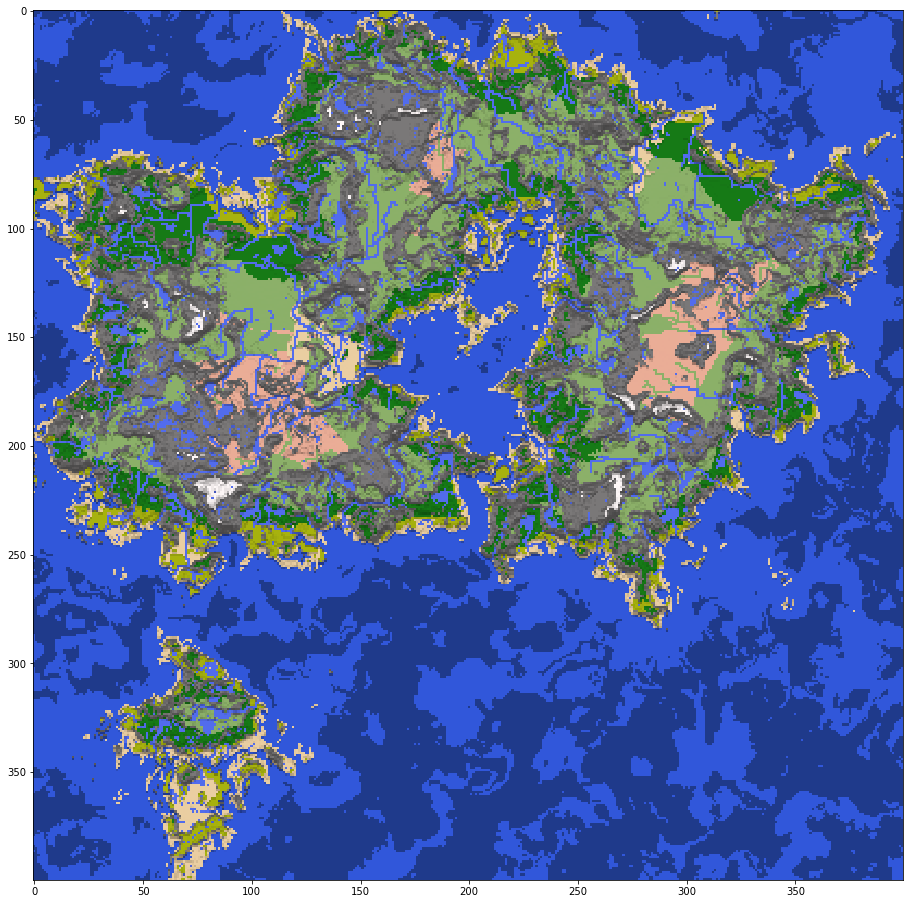

In [233]:
biome_color=dict()
biome_color['deep ocean']=np.array([45,75,155])
biome_color['ocean']=np.array([65,105,225])
biome_color['lake']=np.array([100,125,240])
biome_color['river']=np.array([100,125,240])
biome_color['grassland']=np.array([155,188,122])
biome_color['forest']=np.array([34,139,34])
biome_color['rainforest']=np.array([180,190,24])
biome_color['beach']=np.array([238, 214, 175])
biome_color['desert']=np.array([238, 185, 165])
biome_color['snow']=np.array([255, 250, 250])
biome_color['mountain']=np.array([139, 137, 137])
biome_color['red']=np.array([255, 12, 13])
biome_color['unknown']=np.array([0, 12, 13])
biomeID={name: id for (id, name) in enumerate(biome_color.keys())}
biomeName={id: name for (id, name) in enumerate(biome_color.keys())}
for k,v in enumerate(biomeID):
    biome_color[k]=biome_color[v]

def getBiome(elevation,fill,rain,flow,uneven):
    if elevation < -0.4:
        return 'deep ocean'
    elif elevation < 0:
        return 'ocean'
    else:
        if fill>0.01:
            return 'lake'
        elif flow>1.5/zoom:
            return 'river'
        else:
            if elevation < 0.07:
                return 'beach'
            elif elevation < 0.5:
                if uneven>4:
                    return 'mountain'
                elif rain>0.8 and elevation<0.2:
                    return 'rainforest'
                elif rain+0.5*flow>0.3+0.9*elevation:
                    return 'forest'
                elif rain>0.15 or flow>0.01:
                    return 'grassland'
                else:
                    return 'desert'
            elif elevation < 0.7:
                return 'mountain'
            else:
                return 'snow'
    return 'unknown'


biomes = np.zeros((size,size),dtype=np.int8)
color_unlit = np.zeros((size,size,3))
for i in range(elevation.shape[0]):
    for j in range(elevation.shape[1]):
        name=getBiome(elevation[i,j],fill[i,j],rain[i,j],flow[i,j],uneven[i,j])
        biomes[i,j]=biomeID[name]
        color_unlit[i,j]=biome_color[name]/255
shade=np.cos(np.arctan(gradY)-0.1)*0.4+0.6
color_lit=np.einsum('ijk,ij->ijk',color_unlit,shade)**1.2

plt.figure(figsize=(16,16))
plt.imshow(color_lit,interpolation="nearest")
plt.show()


Now take a coffee and enjoy!

## Day 4, People inhabites

The cruicial condition for a place to become a good settlement are: *water source* and *flat land*. Biomes also affects habitability.

I firstly evaluate the travel distance at every point to nearby *fresh* water. Which can be done in O(NxN) using Dijkstra's algorithm. Travling cost depends on slope and biomes

In [234]:
def pfa(source,cost,banned,cutoff=float('inf')):
    dist=np.zeros((size,size))
    orig=np.zeros((size,size),dtype=np.int8)
    dist.fill(float('inf'))
    orig.fill(-1)
    dirs=((0,1),(1,0),(0,-1),(-1,0))
    opened=[]
    for i in range(size):
        for j in range(size):
            if source[i,j] and not banned[i,j]:
                opened.append((0,i,j,-1))
    heapq.heapify(opened)
    while len(opened)>0:
        d,i,j,o=heapq.heappop(opened)
        if d>cutoff:
            break
        if dist[i,j]>d:
            dist[i,j]=d
            orig[i,j]=(o+2)%4
            for oo,delta in enumerate(dirs):
                ii,jj=i+delta[0],j+delta[1]
                if 0<=ii and ii<size and 0<=jj and jj<size:
                    if not banned[ii,jj]:
                        c=cost[ii,jj,oo]
                        if dist[ii,jj]>d+c:
                            heapq.heappush(opened,(d+c,ii,jj,oo))
    return dist,orig
def sigmoid(x,halfwidth=1):
    return 1/(1+np.exp(-x/(2*halfwidth)))

In [235]:
travel_cost=np.zeros((size,size,4))
travel_cost[:,:,0]=np.abs(gradX)
travel_cost[:,:,1]=np.abs(gradY)
travel_cost[:,:,2]=np.abs(np.roll(gradX,-1,axis=1))
travel_cost[:,:,3]=np.abs(np.roll(gradY,-1,axis=0))#todo check
travel_cost=(travel_cost*5+1)/zoom/travel_zoom
for i in range(size):
    for j in range(size):
        if biomeName[biomes[i,j]] in ['river','lake']:
            travel_cost[i,j,:]=0.1/zoom/travel_zoom
        if biomeName[biomes[i,j]] in ['ocean']:
            travel_cost[i,j,:]=0.2/zoom/travel_zoom
        if biomeName[biomes[i,j]] in ['deep ocean']:
            travel_cost[i,j,:]=0.4/zoom/travel_zoom
            
travel_cost_land=travel_cost.copy()
for i in range(size):
    for j in range(size):
        if biomeName[biomes[i,j]] in ['river','lake']:
            travel_cost_land[i,j,:]=4/zoom/travel_zoom
        if biomeName[biomes[i,j]] in ['ocean','deep ocean']:
            travel_cost_land[i,j,:]=4/zoom/travel_zoom

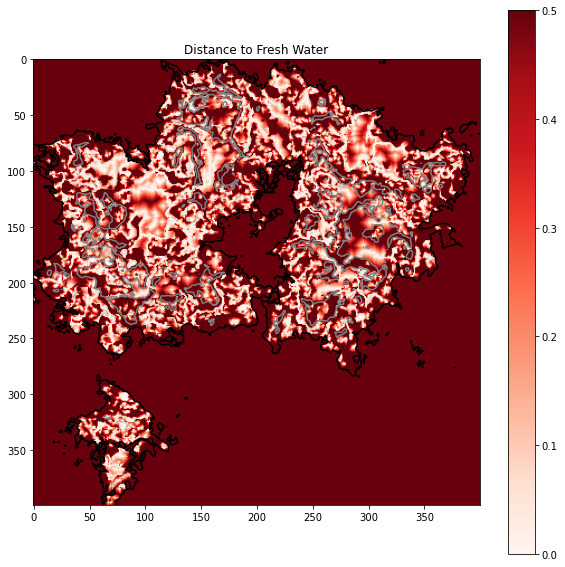

In [236]:
water_dist,dummy=pfa(source=np.isin(biomes,[biomeID['river'],biomeID['lake']]),
                        #cost=np.ones((size,size,4))/zoom,
                        cost=travel_cost,
                        banned=elevation<=0)
plt.figure(figsize=(10,10))
plt.imshow(np.clip(water_dist,0,0.5),cmap='Reds')
plt.colorbar()
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0],colors='black')
plt.contour(elevation,[0.5],colors='grey')
plt.title('Distance to Fresh Water')
plt.show()

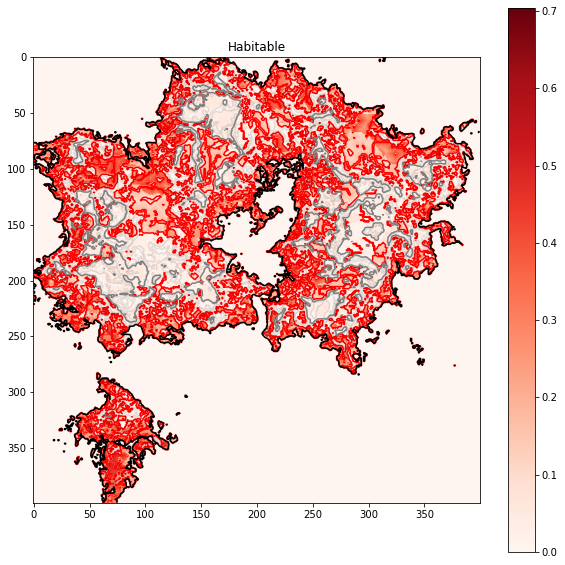

In [237]:
habitable=sigmoid(0.2-water_dist,0.2)+0.5*sigmoid(rain-0.9,0.01)
habitable*=sigmoid(3-uneven,4)
habitable*=\
    +np.where(biomes==biomeID['forest'],1.2,0)\
    +np.where(biomes==biomeID['beach'],0.8,0)\
    +np.where(biomes==biomeID['rainforest'],0.6,0)\
    +np.where(biomes==biomeID['grassland'],0.5,0)\
    +np.where(biomes==biomeID['desert'],0.1,0)\
    +np.where(biomes==biomeID['mountain'],0.2,0)
plt.figure(figsize=(10,10))
plt.imshow(color_lit)
plt.imshow(habitable,cmap='Reds',alpha=1)
plt.colorbar()
plt.contour(habitable,[0.1],colors='red')
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0],colors='black')
plt.contour(elevation,[0.5],colors='grey')
plt.title('Habitable')
plt.show()

One can see people more like to settle at coastal, low-altitude, flat lands. The second popular pattern are inland settlements, they are usually near some major river.

I randomly selected some points as villages based on habitability

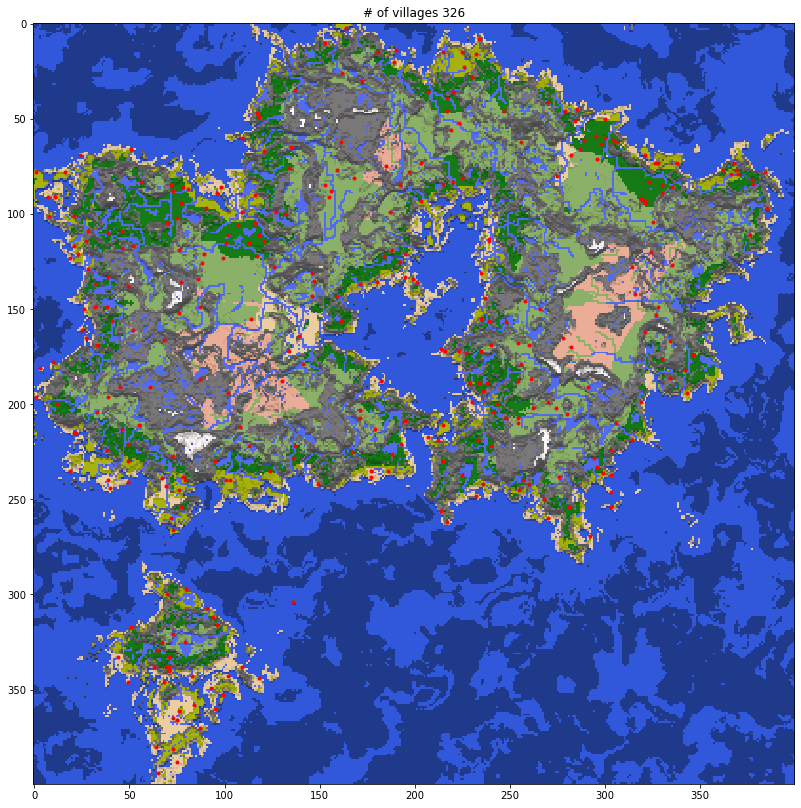

In [238]:
habitable_p=habitable.flatten()/np.sum(habitable)
villages=[]
def getij(ij):
    return int(ij/size),ij%size
np.random.seed(seed+townseed)
for _i in range(int(villagedense*np.sum(habitable)/zoom**2)):
    i,j=getij(np.random.choice(size*size,p=habitable_p))
    villages.append((i,j))
villages=np.array(villages)
plt.figure(figsize=(14,14))
plt.imshow(color_lit,interpolation="nearest")
plt.scatter(villages[:,1],villages[:,0],c='red',marker='.')
plt.title('# of villages {:d}'.format(len(villages)))
plt.show()

## Day 5, People commutes. Town emerges as commercial center. Then people fights. Castles are built to control the traffics

### Day 5.1, Towns
The value for a place to become a trade center depends on how many settlements it can reach within a given travel cost. Unlike settlements, towns relies less on habitability. In fantasy novels there are a lot of towns built on strange place.


The following graph shows how far a village can reach within given travel cost, and how much this village can contribute to the trade value of a town

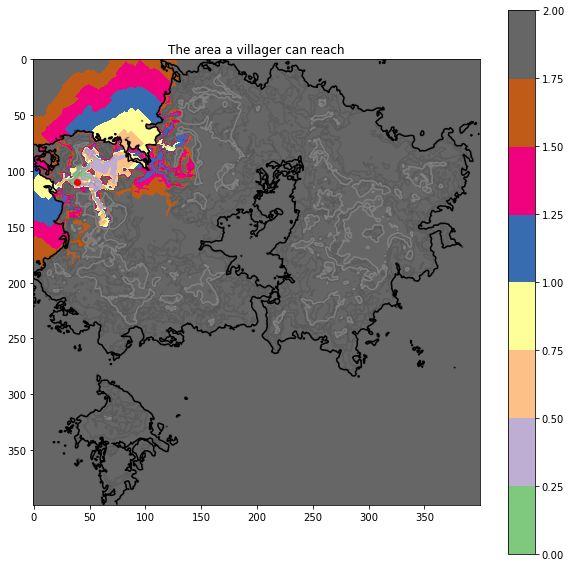

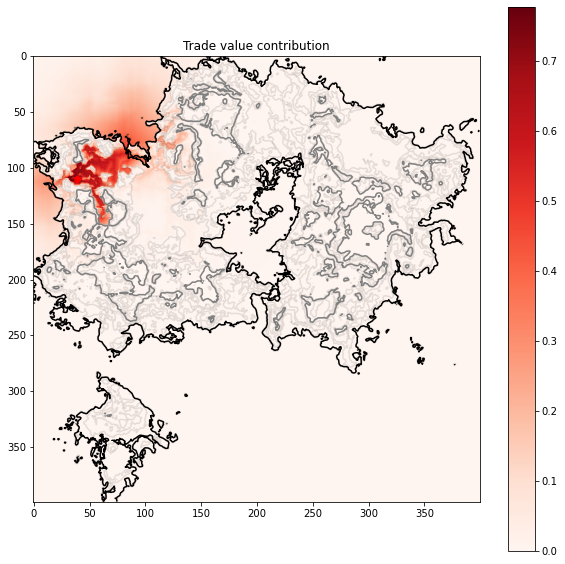

In [239]:
tid=17
source=elevation<-1
source[villages[tid,0],villages[tid,1]]=True
pop_dist,dummy=pfa(source=source,
                    cost=travel_cost,
                    banned=elevation<-1)
plt.figure(figsize=(10,10))
plt.imshow(np.clip(pop_dist,0,2),cmap='Accent')
plt.colorbar()
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0],colors='black')
plt.contour(elevation,[0.5],colors='grey')
plt.scatter(villages[tid,1],villages[tid,0],color='red')
plt.title('The area a villager can reach')
plt.show()

plt.figure(figsize=(10,10))
plt.imshow(sigmoid(0.5-pop_dist,0.2),cmap='Reds')
plt.colorbar()
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0],colors='black')
plt.contour(elevation,[0.5],colors='grey')
plt.scatter(villages[tid,1],villages[tid,0],color='red')
plt.title('Trade value contribution')
plt.show()

100%|████████████████████████████████████████████████████████████████████████████████| 326/326 [00:48<00:00,  6.68it/s]


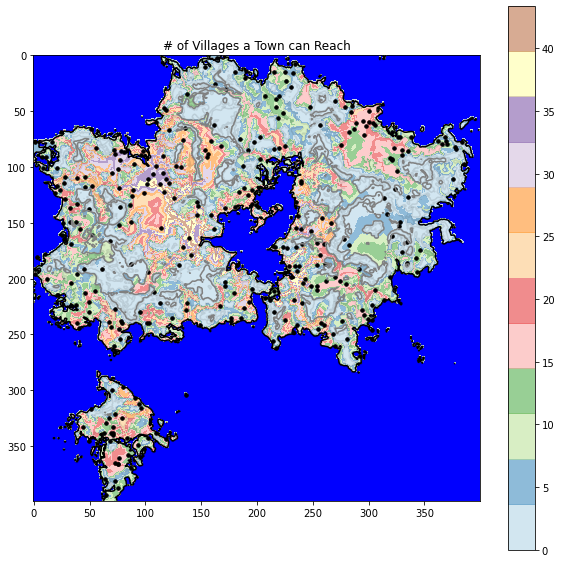

In [240]:
reach=np.zeros((size,size))
np.random.seed(seed+townseed+1)
def addReach(i,j):
    source=elevation<-1
    source[i,j]=True
    pop_dist,dummy=pfa(source=source,
                        cost=travel_cost,
                        banned=elevation<-1,
                        cutoff=2)
    added=sigmoid(1-pop_dist,0.5)
    added[elevation<0]=0
    np.copyto(reach,reach+added)
    
for tid in tqdm(range(villages.shape[0])):
    addReach(villages[tid,0],villages[tid,1])
    '''plt.figure(figsize=(3,3))
    plt.imshow(np.clip(pop_dist,0,1),cmap='Accent')
    #plt.colorbar()
    plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
    plt.contour(elevation,[0],colors='black')
    plt.contour(elevation,[0.5],colors='grey')
    plt.scatter(villages[tid,1],villages[tid,0],color='red')
    plt.show()'''


plt.figure(figsize=(10,10))
plt.imshow(reach,cmap='Paired',alpha=0.5)
plt.colorbar()
plt.imshow(np.ma.masked_where(elevation>0,np.ones(elevation.shape)),cmap='winter')
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0],colors='black')
plt.contour(elevation,[0.5],colors='grey')
plt.scatter(villages[:,1],villages[:,0],c='black',s=12)
plt.title('# of Villages a Town can Reach')
plt.show()


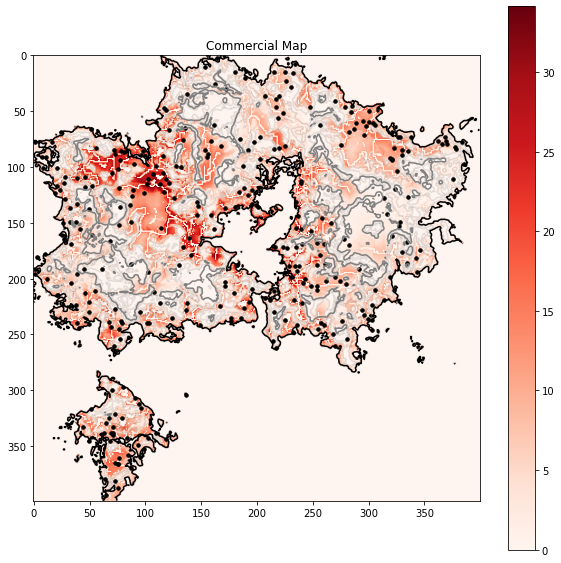

In [241]:
commercial=reach*sigmoid(habitable-0.1,0.1)
commercial[habitable<=0]=0

plt.figure(figsize=(10,10))
#plt.imshow(biomes==biomeID['river'])
plt.imshow(commercial,cmap='Reds')
plt.colorbar()
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0],colors='black')
plt.contour(elevation,[0.5],colors='grey')
plt.scatter(villages[:,1],villages[:,0],c='black',s=12)
plt.title('Commercial Map')
plt.show()

The above map concludes the value/probability a place will be a town. As we expected, besides heavly populated regions, there are also chances for a town to be built deep inside inland deserts. It is because merchants can travel further by river, on sea and on flat ground. 

I again random sample points based on the commercial map. But when I added a new town, I added the contribution of this town as a potential trading destination to the commercial map, like the villages. This "winner takes more" effect will make town clusters

In [242]:
towns=[]
np.random.seed(seed+townseed+1)
for _i in tqdm(range(int(len(villages)/3))):
    commercial=reach*sigmoid(habitable-0.1,0.1)
    commercial[habitable<=0]=0
    commercial_p=commercial.flatten()/np.sum(commercial)
    i,j=getij(np.random.choice(size*size,p=commercial_p))
    towns.append((i,j,reach[i,j]))
    addReach(i,j)
towns=np.array(towns)


100%|████████████████████████████████████████████████████████████████████████████████| 108/108 [00:18<00:00,  5.69it/s]


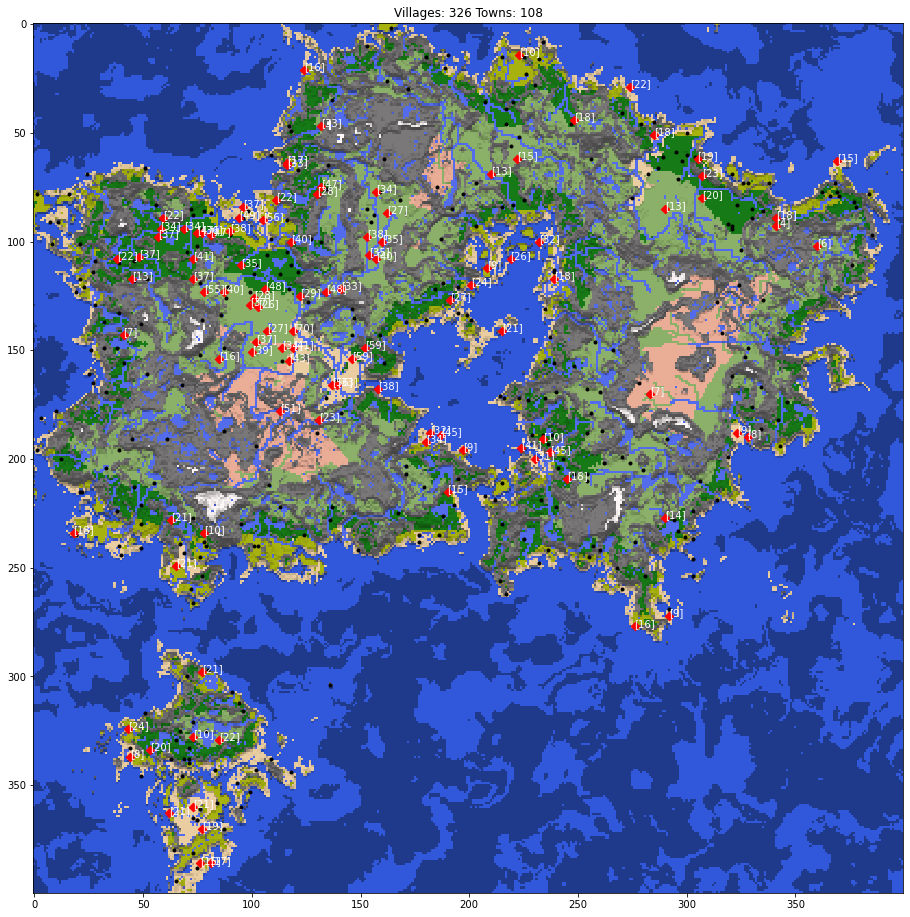

In [243]:
plt.figure(figsize=(16,16))
plt.imshow(color_lit,interpolation="nearest")
plt.scatter(villages[:,1],villages[:,0],c='black',marker='.')
plt.scatter(towns[:,1],towns[:,0],c='red',marker='D')
for i in range(len(towns)):
    plt.annotate("[{:.0f}]".format(towns[i,2]), (towns[i,1], towns[i,0]),color='white')
plt.title("Villages: {:d} Towns: {:d}".format(len(villages),len(towns)))
plt.show()

As we expected, towns are built near river, and river corssovers. Besides for town clusters in heavly populated regions, there are also towns built deep inside less populated inland deserts. It is because merchants can travel further by river and on flat ground, so the town can take advantage from all the settlements surrounding the desert.

The population number annotated in bracket is equal to the number of settlements the town can reach.

Unfortunaly there aren't much costal towns. In the next step we will introduce Castels, which has a further reach, collecting the information concluded by towns globally, thus having a much evident pattern telling us the importance of an area.

### Day 5.2, Castles

The military value of a place depends on how much traffic it can control. It also counts on how much population it should protect. Besides, the terrain with a higher unevenness terrain makes the castle easier to defend. Castles do not take any hostability into account. As in fantasy novels, we would expect to see castles on harsh, epic landscapes.

I let merchants travel from each town to every other town. I recorded their paths to obtain the Traffic Heatmap. 



100%|████████████████████████████████████████████████████████████████████████████████| 108/108 [02:10<00:00,  1.21s/it]


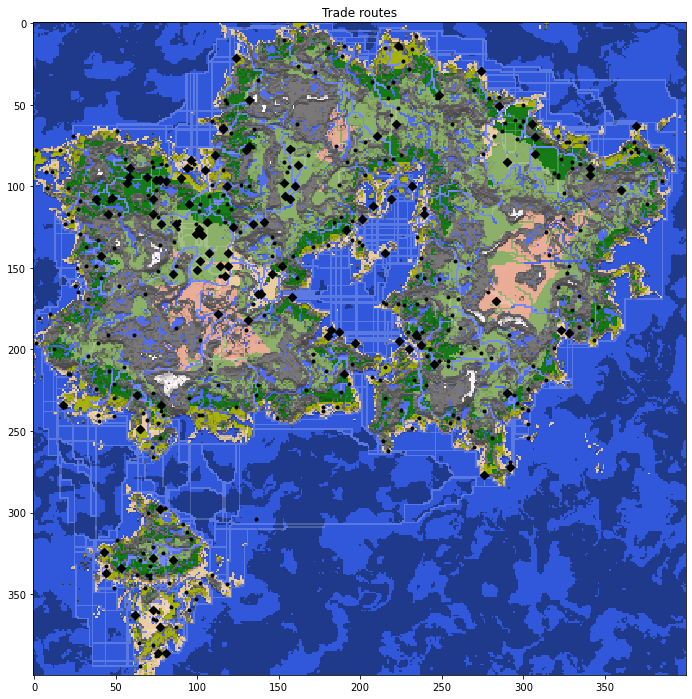

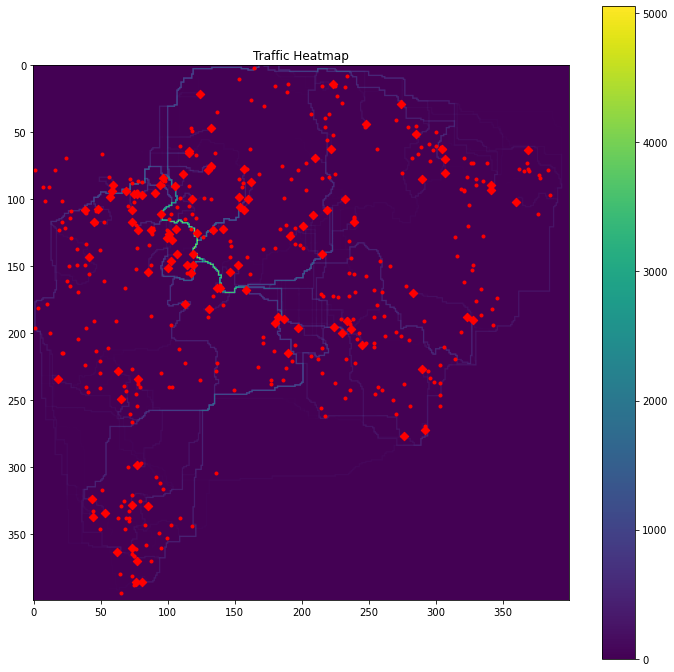

In [244]:
road=np.zeros((size,size))
def walkRoad(road,orig,i,j,idst,jdst,weight=1):
    while i!=idst or j!=jdst:
        road[i,j]+=weight
        o=orig[i,j]
        if o==-1:
            print('dead road!')
            break
        i+=dirs[o][0]
        j+=dirs[o][1]
    road[i,j]+=weight
for _i in tqdm(range(len(towns))):
    i,j=int(towns[_i][0]),int(towns[_i][1])
    source=elevation<-1
    source[i,j]=True
    pop_dist,orig=pfa(source=source,
                        cost=travel_cost,
                        banned=elevation<-1,
                        cutoff=6)
    for _j in range(len(towns)):
        if _j==_i:
            continue
        i1,j1=int(towns[_j][0]),int(towns[_j][1])
        #weight=np.sqrt(towns[_i,2]*towns[_j,2])
        if pop_dist[i1,j1]<6:
            walkRoad(road,orig,i1,j1,i,j,weight=1)
    for _j in range(len(villages)):
        i1,j1=int(villages[_j][0]),int(villages[_j][1])
        if pop_dist[i1,j1]<1.5:
            walkRoad(road,orig,i1,j1,i,j,weight=1)
    '''plt.figure(figsize=(3,3))
    plt.imshow(np.clip(pop_dist,0,1),cmap='Accent')
    #plt.colorbar()
    plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
    plt.contour(elevation,[0],colors='black')
    plt.contour(elevation,[0.5],colors='grey')
    plt.scatter(villages[tid,1],villages[tid,0],color='red')
    plt.show()'''
def blend_mono(source,color,mask):
    a=np.tensordot(mask,[1,1,1],0)
    b=np.tensordot(np.ones(mask.shape),color,0)
    return source*(1-a)+b*a
plt.figure(figsize=(12,12))
plt.imshow(blend_mono(color_lit,[1,1,1],np.where(road>0,0.2,0)),interpolation="nearest")
plt.scatter(villages[:,1],villages[:,0],c='black',marker='.')
plt.scatter(towns[:,1],towns[:,0],c='black',marker='D')
plt.title('Trade routes')
plt.show()
plt.figure(figsize=(12,12))
plt.imshow(road,cmap='viridis')
plt.colorbar()
plt.scatter(villages[:,1],villages[:,0],c='red',marker='.')
plt.scatter(towns[:,1],towns[:,0],c='red',marker='D')
plt.title('Traffic Heatmap')
plt.show()

***
The military value map is based on the [blurred](https://en.wikipedia.org/wiki/Gaussian_filter) traffic map, terrains, and blurred population density. It do not take hostability into account.

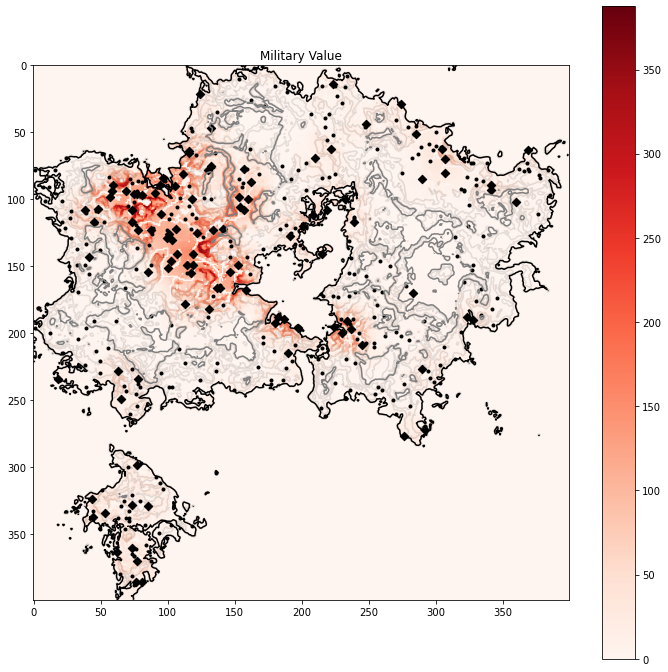

In [245]:
def get_diffuse_kernel(n,normalized=True):
    x,y=np.mgrid[0:n,0:n]
    x,y=x/(n-1)*2-1,y/(n-1)*2-1
    rtval=np.exp(-(x**2+y**2))
    if normalized:
        rtval/=np.sum(rtval)
    return rtval
population=np.zeros((size,size))
for v in villages:
    population[v[0],v[1]]+=1
for t in towns:
    population[int(t[0]),int(t[1])]+=t[2]

military=convolve2d(road,get_diffuse_kernel(np.int(2*zoom*0.4),False),mode='same')
military=military/np.max(military)*np.max(population)
military+=1.0*convolve2d(population,get_diffuse_kernel(np.int(2*zoom*0.6),False),mode='same')
military*=(0.5+sigmoid(uneven-4,0.5))
military[habitable<=0]=0
plt.figure(figsize=(12,12))
plt.imshow(military,cmap='Reds')
plt.colorbar()
plt.contour(np.clip(elevation,0,1),colors='black',alpha=0.1)
plt.contour(elevation,[0],colors='black')
plt.contour(elevation,[0.5],colors='grey')
plt.scatter(villages[:,1],villages[:,0],c='black',marker='.')
plt.scatter(towns[:,1],towns[:,0],c='black',marker='D')
plt.title('Military Value')
plt.show()

***
When doing random sampling, an addition rule is castles are mutually exclusive. A castle built in one place will forbit its nearby area from becoming another castle.

In [246]:
castles=[]
military_masked=military.copy()
#military_p=military.flatten()/np.sum(military)
np.random.seed(seed+6)
for _i in tqdm(range(int(len(villages)/6))):
    #i,j=getij(np.argmax(military_masked))
    military_p=military_masked.flatten()/np.sum(military_masked)
    i,j=getij(np.random.choice(size*size,p=military_p))
    miliwindow=np.zeros((size,size))
    miliwindow[max(0,i-zoom):min(i+zoom,size-1),max(0,j-zoom):min(j+zoom,size-1)]=1
    miliwindow*=military_masked
    i,j=getij(np.argmax(military_masked))
    castles.append((i,j,military[i,j]))# not military masked
    tmp=np.zeros((size,size))
    tmp[i,j]=1
    tmp=1-convolve2d(tmp,get_diffuse_kernel(np.int(2*zoom*1.1),False),mode='same')
    tmp[tmp<0.5]=0
    #plt.imshow(military_tmp,cmap='Reds')
    #plt.show()
    military_masked*=tmp
castles=np.array(castles)

100%|██████████████████████████████████████████████████████████████████████████████████| 54/54 [01:29<00:00,  1.66s/it]


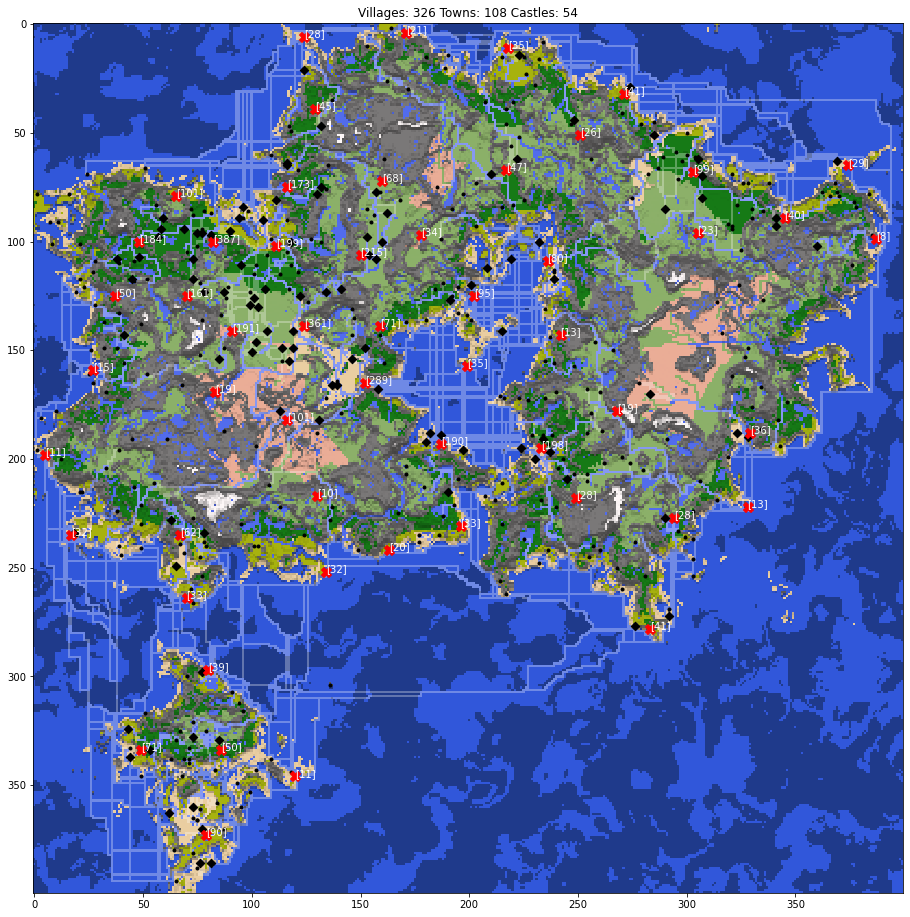

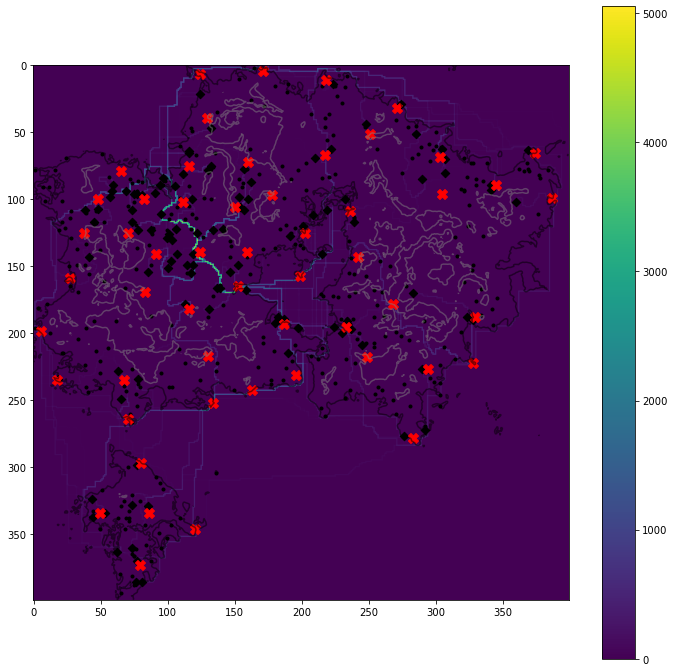

In [247]:
plt.figure(figsize=(16,16))
plt.imshow(blend_mono(color_lit,[1,1,1],np.where(road>0,0.3,0)),interpolation="nearest")
plt.scatter(villages[:,1],villages[:,0],c='black',marker='.')
plt.scatter(towns[:,1],towns[:,0],c='black',marker='D')
plt.scatter(castles[:,1],castles[:,0],c='red',marker='X',s=100)
#for i in range(len(towns)):
#    plt.annotate("{:.0f}".format(towns[i,2]), (towns[i,1], towns[i,0]),color='white')
for i in range(len(castles)):
    plt.annotate("[{:.0f}]".format(castles[i,2]), (castles[i,1], castles[i,0]),color='white')
plt.title("Villages: {:d} Towns: {:d} Castles: {:d}".format(len(villages),len(towns),len(castles)))
plt.show()
plt.figure(figsize=(12,12))
plt.imshow(road,cmap='viridis')
plt.colorbar()
plt.contour(elevation,[0],colors='black',alpha=0.5)
plt.contour(elevation,[0.5],colors='grey',alpha=0.5)
plt.scatter(villages[:,1],villages[:,0],c='black',marker='.')
plt.scatter(towns[:,1],towns[:,0],c='black',marker='D')
plt.scatter(castles[:,1],castles[:,0],c='red',marker='X',s=100)
plt.show()

The population number annoted in bracket is based on the distance-weighted population it can protect, times the factor of traffic importantce. We will take it as the population of the Castle (or City) later.

As expected, there castles on straits, like Constantinople, on islands near major trade routes,like Crete, on entrance of gulfs, like Athens, on Major river and their branching points, like Paris, and on mountain gorges which connects two major flat areas, like Vienna.

## Day 6, Empires rise, then fall apart all in a sudden. As so we have History

Let's build countries over castles, I want to detect the geological clustering relation that which group of castles are strongly connected, so they are usually controlled by the same fraction. Any clustering algorithm should work, but I want countries with different sizes. There is a well-known old-school physics model called [Ising model](https://en.wikipedia.org/wiki/Ising_model) that can achieve [this effect](https://3.bp.blogspot.com/-mAfMEOO8hCo/W5Gvu0zjtBI/AAAAAAAAKf0/tgO2hiUSI8MRF_4Kg3SxWzZdFNO4R_j_QCLcBGAs/s1600/CoarsenedBy0.gif), by emulating the powerplay of fractions over castles.

The charm of Ising Model is it formulate the concept of Reign and Chaos. 

If a pair of adjacent castles are controlled by differnt fractions, then there's a tension, or, "*Energy*" . A system will try to achieve as low energy as possible. When the "*Temperature*" of the system is zero. The *Energy* effect dominates, and all the castle will belong to the same empire. It's dull.

However, a system will also at the same time try to achieve the maximum chaos. That's the "*Entropy*" effect. At infinitly high temperature the *Entropy* dominates, and all the castle will belong to a random fraction each time step. It is insane.

The cruicial thing is, by tweaking the *Temperature*, which controls whether *Energy* or *Entropy* dominate, we can find a point where the two forces, Energy/Entropy, or,  Reign/Chaos, strikes on a dynamic balance. It's called the "*Critical Point*". It's the place where all magic happens. Hierarchy structure emerges, which means we can observe the coexistence of smaller and bigger empires. Butterfly effect also happens, which means a longlasting vast empire might be dramatically overthrown by a small goup of rebels built a few timesteps ago. It is the place where life happens.

***

To realize an ising model we need a interaction matrix. For each castles, the interaction between them describes how likely one castle will yield to another castle's fraction. 

I have also to decide whether two castles are adjacent.

Another thing: armies cannot be transported effectly by water, unlike merchants. So we would expect different countries seperated by seas.

100%|██████████████████████████████████████████████████████████████████████████████████| 54/54 [00:14<00:00,  3.80it/s]


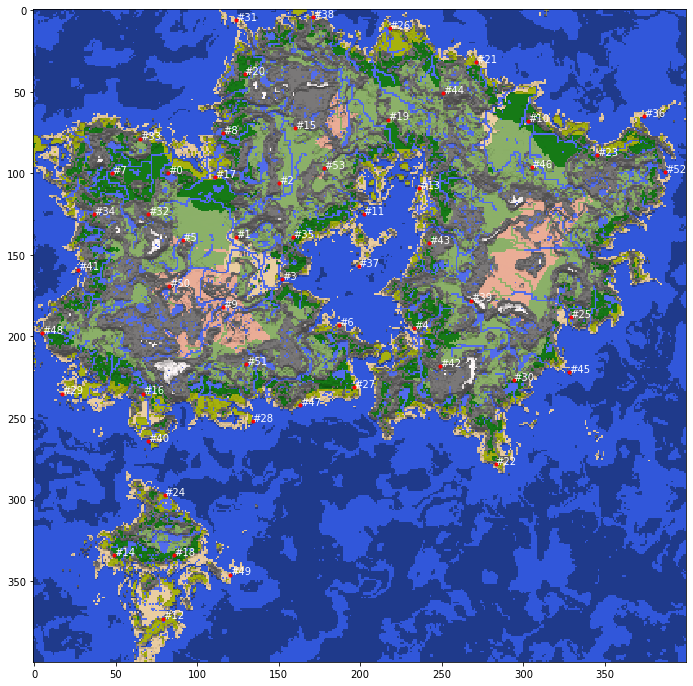

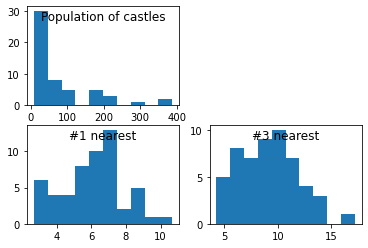

In [248]:
#Do some survey on average castle distance first

nCastles=len(castles)
castles_cutoff=20
castles_weight=castles[:,2]
castles_dist_approx=np.zeros((nCastles,nCastles))
for _i in tqdm(range(nCastles)):
    i,j=int(castles[_i,0]),int(castles[_i,1])
    source=np.full((size,size),False)
    source[i,j]=True
    dist,dummy=pfa(source=source,
                        cost=travel_cost_land,
                        banned=elevation<-1,
                        cutoff=castles_cutoff)
    for _j in range(nCastles):
        if _j!=_i:
            ii,jj=int(castles[_j,0]),int(castles[_j,1])
            castles_dist_approx[_i,_j]=dist[ii,jj]
castles_dist_approx=np.minimum(castles_dist_approx,castles_dist_approx.T)
castles_dist_approx[castles_dist_approx==0]=castles_cutoff
castles_dist_approx[castles_dist_approx==float('inf')]=castles_cutoff
castles_nearest=np.zeros((nCastles,nCastles),dtype=np.int8)
castles_nearest_dist=np.zeros((nCastles,nCastles))

plt.figure(figsize=(12,12))
plt.imshow(color_lit,interpolation="nearest")
plt.scatter(castles[:,1],castles[:,0],c='red',marker='.')
for i in range(nCastles):
    plt.annotate("#{:.0f}".format(i), (castles[i,1], castles[i,0]),color='white')
plt.show()

for _i in range(nCastles):
    castles_nearest[_i]=np.argsort(castles_dist_approx[_i])
    castles_nearest_dist[_i]=castles_dist_approx[_i][castles_nearest[_i]]
#print(castles_nearest)
#print(np.ceil(castles_nearest_dist))
#print(np.ceil(castles_dist_approx))

plt.figure()
plt.subplot(221).hist(castles_weight)
plt.title('Population of castles',y=.8)
#plt.subplot(222).hist(castles_nearest_dist.flatten())
#plt.title('castles_nearest_dist')
plt.subplot(223).hist(castles_nearest_dist[:,0])
plt.title('#1 nearest',y=.8)
plt.subplot(224).hist(castles_nearest_dist[:,2])
plt.title('#3 nearest',y=.8)
plt.show()

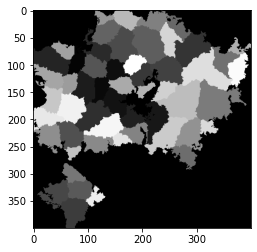

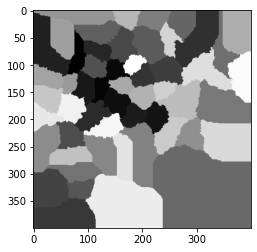

In [270]:
def getCapitalCastle(includeSea=False):
    reign=np.full((size,size),-1,dtype=np.int16)
    dist=np.full((size,size),float('inf'))
    opened=[]
    cost=travel_cost_land
    for _i in range(len(castles)):
        ii,jj=int(castles[_i][0]),int(castles[_i][1])
        opened.append((0,ii,jj,_i))
    heapq.heapify(opened)
    while len(opened)>0:
        d,i,j,r=heapq.heappop(opened)
        if dist[i,j]>d:
            dist[i,j]=d
            reign[i,j]=r
            for oo,delta in enumerate(dirs):
                ii,jj=i+delta[0],j+delta[1]
                if 0<=ii and ii<size and 0<=jj and jj<size:
                    if includeSea or elevation[ii,jj]>-0.15:
                        c=cost[ii,jj,oo]
                        if dist[ii,jj]>d+c:
                            heapq.heappush(opened,(d+c,ii,jj,r))
    return reign
capitalCastleMap=getCapitalCastle()
plt.imshow(capitalCastleMap)
plt.show()

capitalCastleMapWithSea=getCapitalCastle(includeSea=True)
plt.imshow(capitalCastleMapWithSea)
plt.show()

castles_conn=np.full((nCastles,nCastles),False)
for i in range(size-1):
    for j in range(size-1):
        a=capitalCastleMapWithSea[i,j]
        b=capitalCastleMapWithSea[i+1,j]
        c=capitalCastleMapWithSea[i,j+1]
        castles_conn[a,b]=castles_conn[b,a]=True
        castles_conn[a,c]=castles_conn[c,a]=True

100%|██████████████████████████████████████████████████████████████████████████████████| 54/54 [01:23<00:00,  1.54s/it]


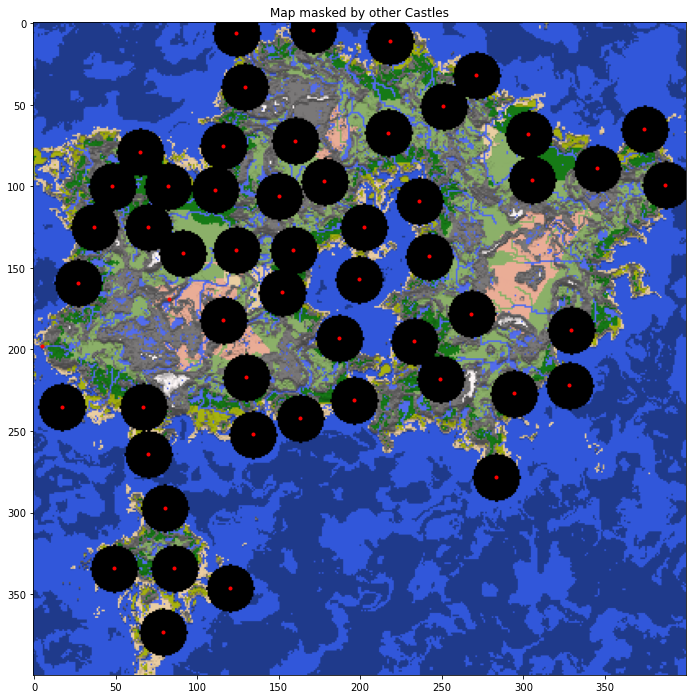

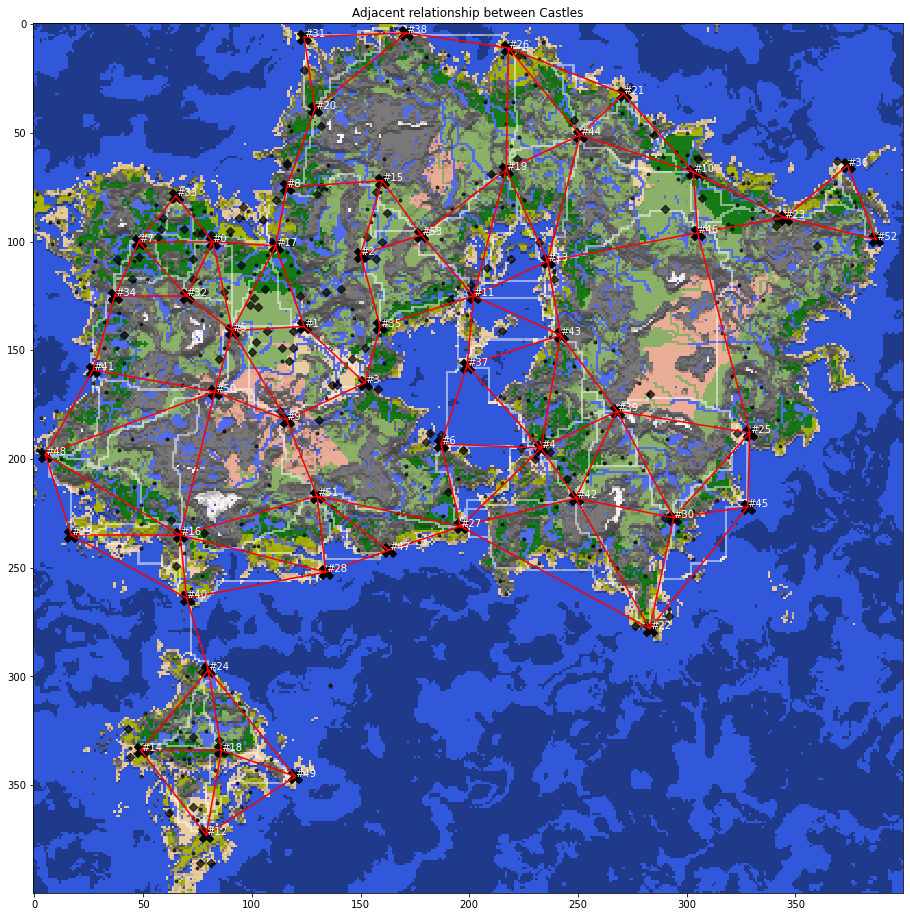

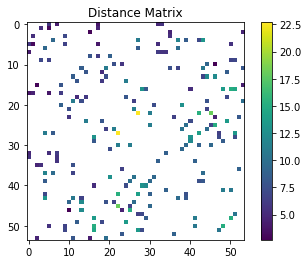

In [271]:
castles_dist=np.full((nCastles,nCastles),float('inf'))
castles_road=np.zeros((size,size))
for _i in tqdm(range(nCastles)):
    i,j=int(castles[_i,0]),int(castles[_i,1])
    source=np.full((size,size),False)
    source[i,j]=True
    castles_cutoff2=castles_nearest_dist[_i,2]*1.5
    for _j in range(nCastles):
        if _j>_i and castles_conn[_i,_j]:
            banned=np.zeros((size,size))
            for _k in range(nCastles):
                if _k!=_i and _k!=_j:
                    iii,jjj=int(castles[_k,0]),int(castles[_k,1])
                    banned[iii,jjj]=1
            banned=convolve2d(banned,
                              np.where(get_diffuse_kernel(np.int(2*zoom*0.6),False)>0.5,1,0),mode='same')>0
            ii,jj=int(castles[_j,0]),int(castles[_j,1])
            dist,orig=pfa(source=source,
                                cost=travel_cost_land,
                                banned=banned,
                                cutoff=castles_cutoff2)
            #print(_i,_j,castles_dist[_i,_j],dist[ii,jj])
            if dist[ii,jj]<=castles_cutoff2:
                walkRoad(castles_road,orig,ii,jj,i,j,weight=1)
                castles_dist[_i,_j]=castles_dist[_j,_i]=dist[ii,jj]
            else:
                castles_conn[_i,_j]=castles_conn[_j,_i]=False
    #plt.imshow(blend_mono(color_lit,[1,0,0],np.where(castles_road>0,1,0)))
    #plt.scatter(castles[:,1],castles[:,0],c='red',marker='.')
    #plt.show()
    #castles_road=np.zeros((size,size))
    #assert(False)
plt.figure(figsize=(12,12))
plt.imshow(blend_mono(color_lit,[0,0,0],banned))
plt.scatter(castles[:,1],castles[:,0],c='red',marker='.')
plt.title("Map masked by other Castles")
plt.show()

fig =plt.figure(figsize=(16,16))
ax = fig.gca()
plt.imshow(blend_mono(color_lit,[1,1,1],np.where(castles_road>0,0.5,0)),interpolation="nearest")
#plt.imshow(color_lit)
plt.scatter(castles[:,1],castles[:,0],c='black',marker='X',s=200)
plt.scatter(villages[:,1],villages[:,0],c='black',marker='.',alpha=0.7)
plt.scatter(towns[:,1],towns[:,0],c='black',marker='D',alpha=0.7)
nCastles=len(castles)
for k in range(nCastles):
    plt.annotate("#{:d}".format(k), (castles[k,1], castles[k,0]),color='white')
for _i in range(nCastles):
    i,j=int(castles[_i,0]),int(castles[_i,1])
    for _j in range(nCastles):
        if _j>_i and castles_conn[_i,_j]:
            ii,jj=int(castles[_j,0]),int(castles[_j,1])
            line=matplotlib.lines.Line2D([j,jj],[i,ii],color='red')
            ax.add_line(line)
plt.title("Adjacent relationship between Castles")
plt.show()

plt.colorbar(plt.imshow(castles_dist,cmap='viridis'))
plt.title("Distance Matrix")
plt.show()

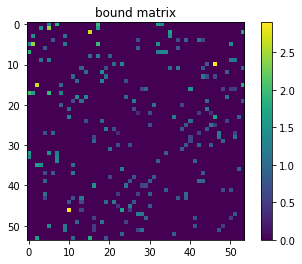

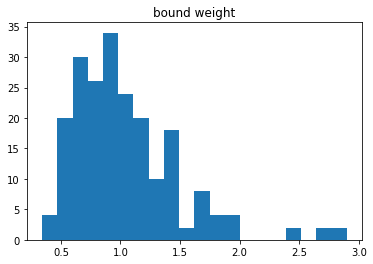

In [273]:
#bound=(np.tensordot(castles[:,2],np.ones(nCastles),0)\
#    *np.tensordot(np.ones(nCastles),1/castles[:,2],0))\
#    /castles_dist
bound=np.ones((nCastles,nCastles))/castles_dist
#bound=(np.tensordot(castles[:,2],np.ones(nCastles),0)\
#    *np.tensordot(np.ones(nCastles),castles[:,2],0))\
#    /castles_dist
tmp=bound.flatten()
bound=np.clip(bound/np.average(tmp[tmp!=0]**.5)**2,0,10)
plt.colorbar(plt.imshow(bound,cmap='viridis'))
plt.title('bound matrix')
plt.show()
plt.hist(bound.flatten()[bound.flatten()>0],bins=20)
plt.title('bound weight')
plt.show()

***
The standary way to simulate an Ising model is the [Monte Carlo Algorithm](https://en.wikipedia.org/wiki/Ising_model#Metropolis_algorithm). However, it takes exponentially long time for a bigger empire to be overthrown. This is not interesting. So I considered a more efficient [Cluster Monte Carlo (Wolff) Algorithm](http://csml.northwestern.edu/resources/Reprints/lnp_color.pdf). Which can flip the entire empire into another fraction one time in a row.

***

The basic Monte Carlo method is: for each time step, you randomly chose a castle, and temporaily change its fraction randomly. Then you evaluate the energy change ΔE. If ΔE<0, (which indicates the castle might be aligned to its nearby fraction), the change is accepted automatically. If ΔE>0, (which means new military tensions are created), the change can only happen with a probability exp(-ΔE/Tempreature).
 
(To review, zero temperature means infinitely small energy increase probability, so energy effect dominates, and infinite temperature means the probability of energy increasning and decreasing become the same, so the interaction no longer take effect and it become totally random)
 
***

The basic idea of Wolff method is, when a castle is flipped, all the nearby castles with the same fraction will have a change to be flipped together. Intuitively, it simulates a marching army (or mobs). In my implementation, I let two armies run parallel. Also I do not let them flip the whole cluster once at a time, but only flip one castle at a timestep and march to the next castle in the next timestep.

(I did not prove the mathematical correctness that whether my implementation will sample on the correct probability distribution as defined by the Ising model. However, I believe that Ising model is in the field of Statistical Mechanicals, and SM is all about doing average above chaso, some theoretical flaw should not matter much)

(Note that in my code beta=1/Temperature)

In [309]:
# Introduction to Cluster Monte Carlo Algorithms
# http://csml.northwestern.edu/resources/Reprints/lnp_color.pdf

alignment=np.array(range(nCastles))
alignment_count=np.ones(nCastles,dtype=np.int8)
E=0
np.random.seed(seed+histseed+2)

start_year=-1000
total_years=2500
steps_per_year=max((nCastles/60),1)
total_steps=int(total_years*steps_per_year)
opened,closed,oldA,newA=[],[],-1,-1
rotation=[[],[],-1,-1]
snapshots=[]
migration=[]

assert bound[0,0]==0

for _i in tqdm(range(total_steps)):
    year=int(_i/steps_per_year)+start_year
    temperature=1.2
    alignment_count=np.array([np.sum(alignment==j) for j in range(nCastles)])
    rotation,opened,closed,oldA,newA=[opened,closed,oldA,newA],rotation[0],rotation[1],rotation[2],rotation[3]
    if len(opened)==0: #choose a new alignment
        #target=np.random.randint(nCastles)
        tmp=np.tensordot(alignment,np.ones(nCastles),0)
        p=(np.sum((tmp!=tmp.T)*bound,0)+1)/castles[:,2]
        #p=1/castles[:,2]
        target=np.random.choice(nCastles,p=p/np.sum(p))
        oldA=alignment[target]
        p=bound[target,:].copy()
        #p[target]=np.sum(p) #random choose
        p[target]=1
        origin=np.random.choice(nCastles,p=p/np.sum(p))
        newA=alignment[origin] if origin!=target else target # can also be random, but I think they may use the same nation name as their ancester
        #newA=np.random.randint(nCastles)
        #newA=alignment[origin] if origin!=target else np.random.randint(nCastles)
        opened.append((target,origin))
        closed=[]
    if len(opened)>0:
        # flip according to opened
        target,origin=opened.pop(-1)#-1 dfs +1 bfs
        alignment[target]=newA
        # add neighbors to opened
        for forward in range(nCastles):
            if castles_conn[target,forward]:
                if alignment[forward]==oldA and not forward in closed:
                    if temperature==0:
                        acceptance=1
                    else:
                        acceptance=1-exp(-2*bound[target,forward]/temperature)
                    closed.append(forward)
                    if np.random.random()<acceptance:
                        opened.append((forward,target))
    else:
        target,origin=-1,-1
    #statistics
    if origin!=-1:
        migration.append((origin,target,newA))
    if np.floor(year)!=np.floor(year-1/steps_per_year):
        tmp=np.tensordot(alignment,np.ones(nCastles),0)
        energy=np.sum((tmp!=tmp.T)*bound)
        maxAlignmentSize=np.max(np.unique(alignment,return_counts=True)[1])
        snapshots.append({'temperature':temperature,
                          'alignment':alignment.copy(),
                          'year':year,
                          'energy':energy,
                          'alignment_count':len(set(alignment)),
                          'opened_size':len(opened),
                          'migration':migration,
                          'max_alignment_size':maxAlignmentSize
                         })
        migration=[]

100%|████████████████████████████████████████████████████████████████████████████| 2500/2500 [00:00<00:00, 2568.18it/s]


temperature = 1.2 	# of castles = 54


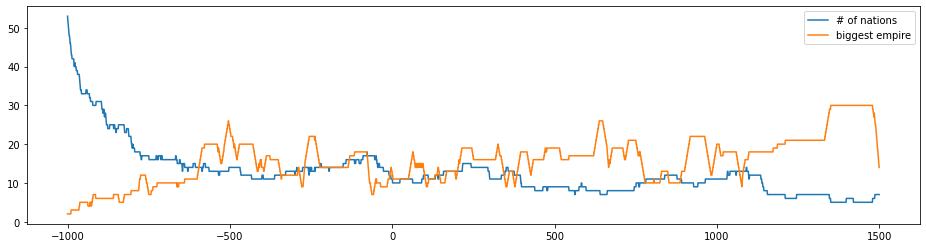

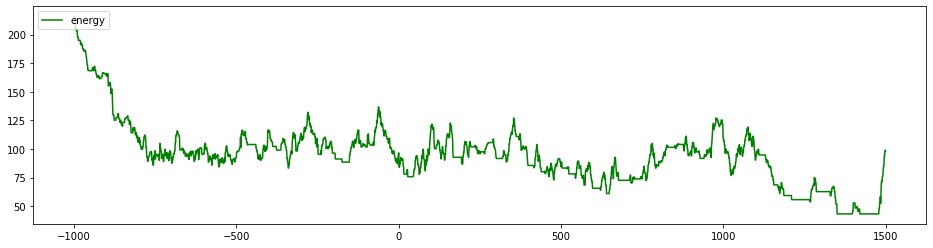

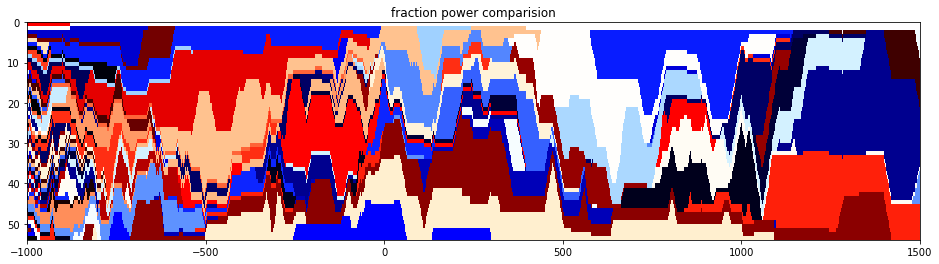

In [315]:

years=[i['year'] for i in snapshots]

print('temperature =',temperature,'\t# of castles =',nCastles)

plt.figure(figsize=(16,4))
plt.plot(years,[i['alignment_count'] for i in snapshots])
plt.plot(years,[i['max_alignment_size'] for i in snapshots])
plt.legend(['# of nations','biggest empire'])
plt.show()

plt.figure(figsize=(16,4))
plt.plot(years,[i['energy'] for i in snapshots],'green')
plt.legend(['energy'],loc='upper left')
plt.show()

plt.figure(figsize=(16,4))
roll=np.zeros((total_steps, nCastles))
for i in range(total_steps):
    roll[i]=np.sort(snapshots[i]['alignment'])
plt.imshow(roll.T,interpolation='nearest', aspect='auto',cmap='flag',extent=[start_year,start_year+total_years,nCastles,0])
plt.title('fraction power comparision')
plt.show()



From the simulation, one can see, at the beginning, there's totally chaos. Then countries combines and the first empires were built. One can also see that as the history evolves, the world sways between chaos ages, with small countries and high energy, and reign ages, with big empires and lower energies.

One have to fine tune the temperature parameter for each new map. At the critical point you will find both bigger and smaller fractions in the power comparision graph.


***
Now let's draw some maps. We can also export animations for the history period one is interested in

In [346]:
country_names=["Dumar","Danrus ","Boramar","Ranor","Toigua","Lena","Vanina","Poand ","Netonga","Tuha","Runi ","Hongco ","Newne","Bangstan","Momanew","Cocamkong","Brintarc ","Tatralmau","Statesi","Bisvezstan","Macto","Haser","Diagal","Sritoediland","Netan Tuva","Tibo ","Siagreendom","Souing Reafriland","Debo ","Engtaja","Costa Spainlia","Stancai","Scotva","Rusmabu","Lelein","Caithe"]*10
color_cycle=['r','g','b','c','m','y','red','green','blue','pink','purple','yellow','olive','orange','slateblue','teal','aqua','cyan','darkred','brown','azure','royalblue','gold']*10


<ipython-input-347-0716a15a09a5>:81: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


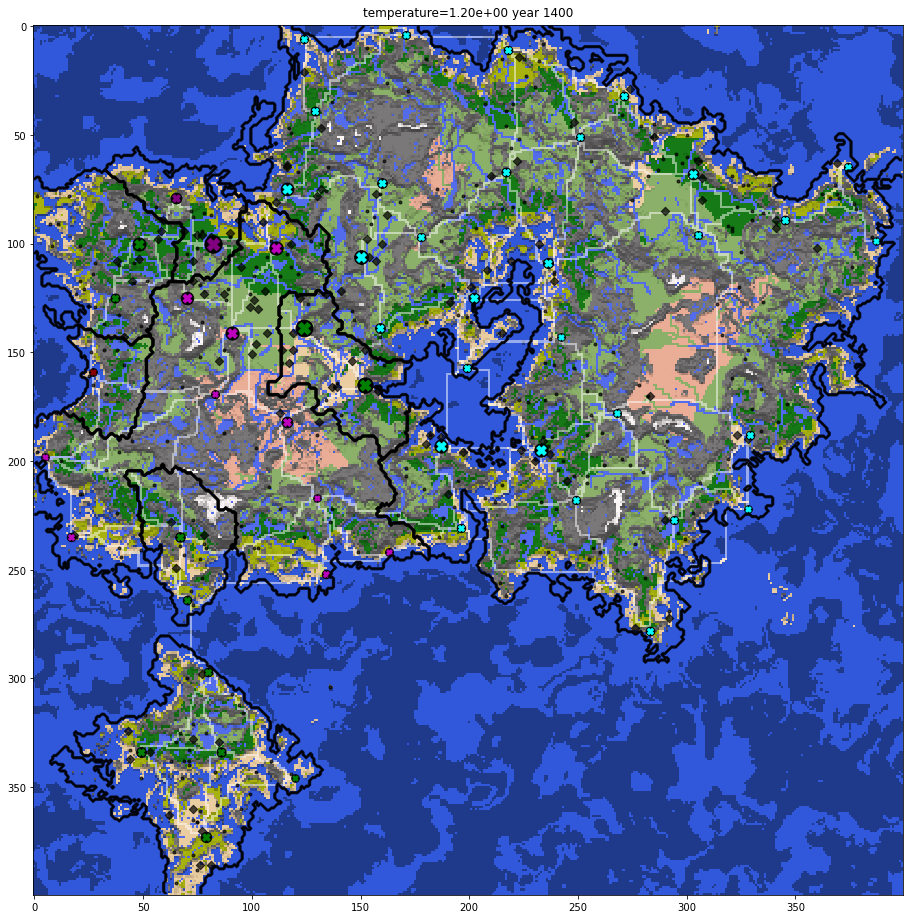

In [347]:

def drawMap(fig,alignment,title,name_length=10,alpha_politic=0.5,migration=[]):
    color_output=color_lit.copy()
    patches=[]
    ax = fig.gca()
    xcoord1,ycoord1=np.mgrid[0:size,0:size]
    for a in range(nCastles):
        reign=np.zeros((size,size))
        for c in range(nCastles):
            if alignment[c]==a:
                reign[capitalCastleMap==c]=1
        reign=reign>0
        
        nationsize=np.sum(np.where(reign,1,0))
        nationpop=np.sum(castles[alignment==a,2])
        if nationsize>0:
            patches+=plt.contour(reign,colors='black',alpha=0.5).collections 
            #x=np.sum(xcoord1,where=reign)/nationsize
            #y=np.sum(ycoord1,where=reign)/nationsize
            maxPop=0
            for c in range(nCastles):
                if alignment[c]==a:
                    if castles[c,2]>maxPop:
                        maxPop=castles[c,2]
                        x=castles[c,0]+4
                        y=castles[c,1]+2
            #x=np.sum(castles[:,0],where=alignment==a)/np.sum(np.where(alignment==a,1,0))
            #y=np.sum(castles[:,1],where=alignment==a)/np.sum(np.where(alignment==a,1,0))
            color=color_cycle[a]
            name=country_names[a][:name_length]
            if True and name_length>0:
                t=plt.annotate(name+"({:.0f})".format(nationpop), (y,x),color=np.array(to_rgba(color))*.7,weight='bold')
                t.set_bbox(dict(facecolor='white', alpha=1, edgecolor=color))
                patches+=[t]
            color_output=blend_mono(color_output,matplotlib.colors.to_rgb(color),np.where(reign,alpha_politic,0))
    color_output=blend_mono(color_output,[1,1,1],np.where(castles_road>0,0.5,0))
    patches+=[plt.imshow(color_output,interpolation="nearest")]
    
    patches+=[plt.scatter(villages[:,1],villages[:,0],c='black',marker='.',alpha=0.7)]
    patches+=[plt.scatter(towns[:,1],towns[:,0],c='black',marker='D',alpha=0.7)]
    #patches+=[plt.scatter(castles[:,1],castles[:,0],c='red',marker='X',s=200)]
    
    for k in range(nCastles):
        color=color_cycle[alignment[k]]
        name=country_names[alignment[k]][:name_length]
        markerSize=50+250/np.max(castles[:,2])*castles[k,2]
        patches+=[plt.scatter(castles[k,1],castles[k,0],c='black',marker='o',s=markerSize)]
        patches+=[plt.scatter(castles[k,1],castles[k,0],c=color,marker='X',s=markerSize/2)]
        if False:
            t=plt.annotate(name+"({:.0f})".format(castles[k,2]),
                         (castles[k,1], castles[k,0]),color=color,weight='bold')
            t.set_bbox(dict(facecolor='white', alpha=.7, edgecolor=color))
            patches+=[t]
        if False:
            for _i in range(nCastles):
                i,j=int(castles[_i,0]),int(castles[_i,1])
                for _j in range(nCastles):
                    if _j>_i and castles_conn[_i,_j]:
                        ii,jj=int(castles[_j,0]),int(castles[_j,1])
                        line=matplotlib.lines.Line2D([j,jj],[i,ii],color='black')
                        ax.add_line(line)
                        patches+=[line]
    for mig in migration:
        i,j=int(castles[mig[0],0]),int(castles[mig[0],1])
        ii,jj=int(castles[mig[1],0]),int(castles[mig[1],1])
        color=color_cycle[mig[2]]
        patches+=[plt.arrow(j,i,jj-j,ii-i,color='red',width=1)]
    title_obj = ax.text(0.5,1.01,title, 
                    size=plt.rcParams["axes.titlesize"],
                    ha="center", transform=ax.transAxes, )
    patches+=[title_obj]# title is buggy
    #plt.show()
    return patches


snapshot=snapshots[int((1400-start_year)*steps_per_year)]

fig=plt.figure(figsize=(16,16))
patches=drawMap(fig,snapshot['alignment'],
                title="temperature={:.2e} year {:.0f}".format(snapshot['temperature'],snapshot['year']),
               alpha_politic=0,name_length=0)
fig.show()

100%|██████████████████████████████████████████████████████████████████████████████████| 25/25 [00:52<00:00,  2.11s/it]


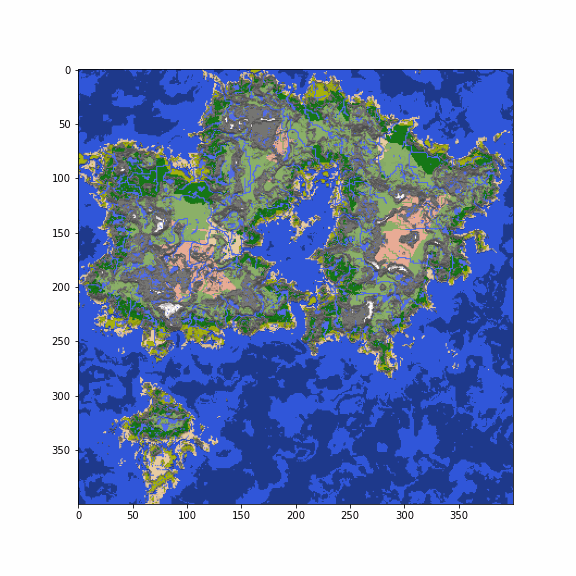

In [340]:
fig = plt.figure(figsize=(8,8))
ims = [[plt.imshow(color_lit)]]
start,end,interval=-1000,1500,100
for year in tqdm(range(int((start-start_year)*steps_per_year),min(int((end+interval-start_year)*steps_per_year),total_steps),int(interval*steps_per_year))):
    title="temperature={:.2e} year {:.0f}".format(snapshots[year]['temperature'],snapshots[year]['year'])
    mig=[inner for outer in [j['migration'] for j in snapshots[max(0,year-interval+1):year+1]] for inner in outer]
    patches=drawMap(fig,snapshots[year]['alignment'],title,name_length=5,migration=mig)
    ims.append(patches)
plt.close()
ani = animation.ArtistAnimation(fig, ims, interval=3000, blit=False)
ani.save("ani.gif", writer='pillow')
with open('ani.gif','rb') as file:
    display(Image(file.read()))

100%|██████████████████████████████████████████████████████████████████████████████████| 26/26 [00:34<00:00,  1.32s/it]


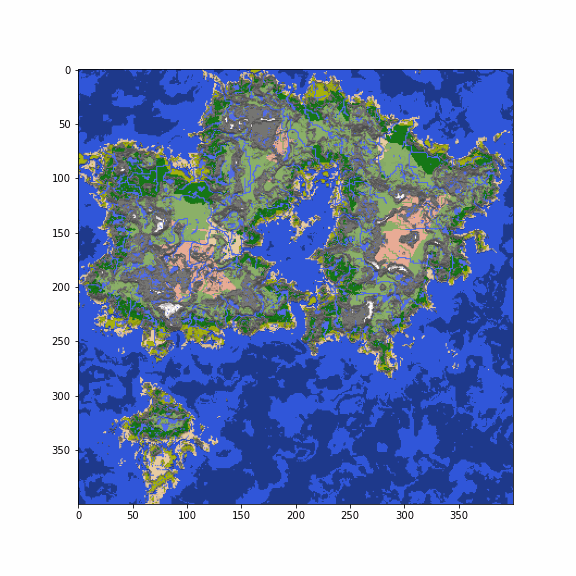

In [344]:
fig = plt.figure(figsize=(8,8))
ims = [[plt.imshow(color_lit)]]
start,end,interval=500,750,10
for year in tqdm(range(int((start-start_year)*steps_per_year),min(int((end+interval-start_year)*steps_per_year),total_steps),int(interval*steps_per_year))):
    title="temperature={:.2e} year {:.0f}".format(snapshots[year]['temperature'],snapshots[year]['year'])
    mig=[inner for outer in [j['migration'] for j in snapshots[max(0,year-interval+1):year+1]] for inner in outer]
    patches=drawMap(fig,snapshots[year]['alignment'],title,name_length=5,migration=mig)
    ims.append(patches)
plt.close()
ani = animation.ArtistAnimation(fig, ims, interval=1500, blit=False)
ani.save("ani.gif", writer='pillow')
with open('ani.gif','rb') as file:
    display(Image(file.read()))

100%|██████████████████████████████████████████████████████████████████████████████████| 18/18 [00:22<00:00,  1.25s/it]


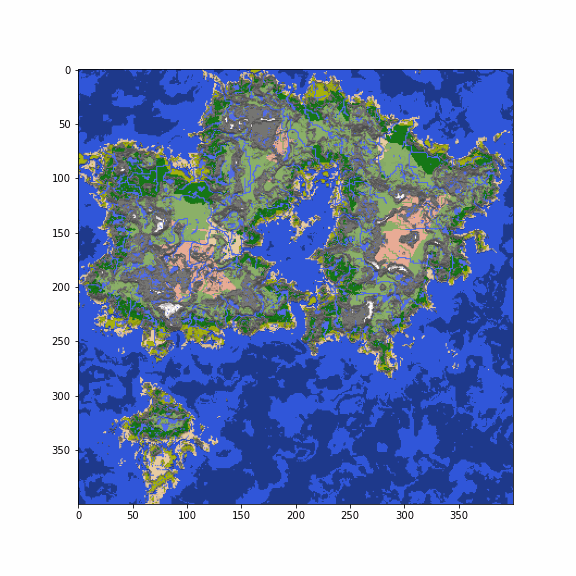

In [345]:
fig = plt.figure(figsize=(8,8))
ims = [[plt.imshow(color_lit)]]
start,end,interval=1100,1150,3
for year in tqdm(range(int((start-start_year)*steps_per_year),min(int((end+interval-start_year)*steps_per_year),total_steps),int(interval*steps_per_year))):
    title="temperature={:.2e} year {:.0f}".format(snapshots[year]['temperature'],snapshots[year]['year'])
    mig=[inner for outer in [j['migration'] for j in snapshots[max(0,year-interval+1):year+1]] for inner in outer]
    patches=drawMap(fig,snapshots[year]['alignment'],title,name_length=5,migration=mig)
    ims.append(patches)
plt.close()
ani = animation.ArtistAnimation(fig, ims, interval=700, blit=False)
ani.save("ani.gif", writer='pillow')
with open('ani.gif','rb') as file:
    display(Image(file.read()))

## Day 7, It's human's turn


Several years ago, I thought about a philosophy problem, that if the computer generated stuffs are artworks? The basic idea comes from one of Liu Cixin's novel: The Cloud of Poems. In the story, someone used a supercomputer to enumerate all the possible combinations of characters within a given length (for example, 1000 bytes). Then he claimed that he has created all the possible poems (within that length) in the world, and all the poet will lost their job.

However, one suddenly realized that, in order to access the Cloud of Poem database, the length of the index for a poem is exactly 1000 bytes long, as long as the poem itself. So in order to find a poem you have to generate a 1000-byte long index: you created the poem by yourself!

What I learnt from this simple story is that the process of aestheticise is also the process of creation. 

Let me explain my understanding. For a white paper, it has infinite possibilities. Each strock you draw, you [reduce](https://github.com/mxgmn/WaveFunctionCollapse) the number of possibilities that the artwork will be. However, the artwork become more refined and more completed. By completing the artwork, you choose what this artwork will be. By choosing you are creating. Still, after completion, an artwork remains possibilities that one can intepret it in different ways. So the audience will complete the last lap of art creation. One decides how one would understand this artwork. So he or she creates, also.

So there is no different by creating a 1000px* 1000px painting from scratch, or choosing you favourite image generated by a [generative adversarial network](https://en.wikipedia.org/wiki/Generative_adversarial_network). The both behavior are art creation. The only difference is the amount of information you created. For the first case you created 3MB, for the second case you created several Bytes.

So, the last step to complete this fantasy world map, is to imagine what happens in this world. I believed in the future, the computer (or AI)  generation will coexist with human art creation, by acting as a rich inspiration source and a solid visualization tool. The world map generated above trigged me so many fantasy novels I have read. I could imaging travellers struggling in the desert, carrying cargos from a distant southern island he purchased in the jungle port. I could imagine elves parliament argues about how to send troops to their colony with land rout cut off by barbarians. I could also imagine a foreign empire rises in the barren east, and suddenly become a deadly threat for the core civilization. And when I became bored about those ideas, I can look up into real world, and come up with new ideas I can added into my code.
